# *Modern Deep Learning for Tabular Data*, Chapter 4

**Applying Convolutional Structures to Tabular Data**

This notebook contains the complementary code discussed in Chapter 4 of *Modern Deep Learning for Tabular Data*.

External Kaggle links to datasets used in this notebook:
- [UCI Forest Cover Type Dataset](https://www.kaggle.com/datasets/uciml/forest-cover-type-dataset)
- [Mouse Protein Expression Dataset](https://www.kaggle.com/datasets/washingtongold/mpempe)
- [SoCal House Prices and Images](https://www.kaggle.com/datasets/ted8080/house-prices-and-images-socal)

You can download these datasets from Kaggle, or import these notebooks into Kaggle and connect them internally.

---

## Imports

In [ ]:
# data management
import numpy as np                   # for linear algebra
import pandas as pd                  # for tabular data manipulation and processing

# machine learning
import sklearn                       # for data prep and classical ML
import tensorflow as tf              # for deep learning
from tensorflow import keras         # for deep learning
import keras.layers as L             # for easy NN layer access

# data visualization and graphics
import matplotlib.pyplot as plt      # for visualization fundamentals
import seaborn as sns                # for pretty visualizations
import cv2                           # for image manipulation
from skimage import io               # for input/output processing

# misc
from tqdm.notebook import tqdm       # for progress bars
import math                          # for calculation
import sys                           # for system manipulation
import os                            # for file manipulation

---

## Convolutional Neural Network Theory

### Why Do We Need CNNs?

Loading the MNIST dataset.

In [ ]:
from keras.datasets.mnist import load_data as load_mnist
(x_train, y_train), (x_val, y_val) = load_mnist()

11501568/11490434 [==============================] - 0s 0us/step


Visualizing elements from the dataset.

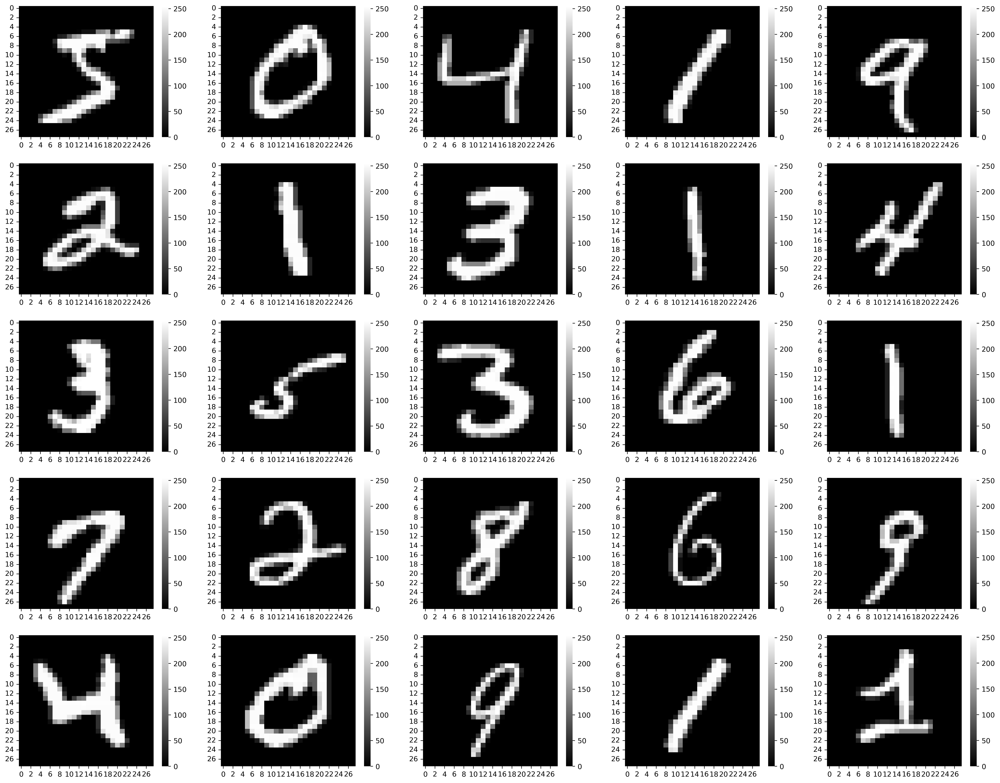

In [ ]:
plt.figure(figsize=(25, 20), dpi=400)
for i in range(5):
    for j in range(5):
        plt.subplot(5, 5, i*5 + j + 1)
        sns.heatmap(x_train[i*5 + j], cmap='gray')
        plt.yticks(rotation=0)
plt.show()

"Flattening" the shapes from two spatial dimensions (shape `(28, 28)`) to one spatial dimension (shape `(784,)`).

In [ ]:
x_train = x_train.reshape(len(x_train), 
                          x_train.shape[1] * x_train.shape[2])
x_val = x_val.reshape(len(x_val),
                      x_val.shape[1] * x_val.shape[2])

Programmatically generating a model to fit the 'flattened' MNIST dataset.

In [ ]:
model = keras.models.Sequential()
curr_nodes = 28 * 28
model.add(L.Input((curr_nodes,)))
while curr_nodes > 10 * 2:
    curr_nodes = round(1/2 * curr_nodes)
    model.add(L.Dense(curr_nodes,
                      activation='relu'))
model.add(L.Dense(10, activation='softmax'))


User settings:

   KMP_AFFINITY=granularity=fine,verbose,compact,1,0
   KMP_BLOCKTIME=0
   KMP_DUPLICATE_LIB_OK=True
   KMP_INIT_AT_FORK=FALSE
   KMP_SETTINGS=1
   KMP_WARNINGS=0

Effective settings:

   KMP_ABORT_DELAY=0
   KMP_ADAPTIVE_LOCK_PROPS='1,1024'
   KMP_ALIGN_ALLOC=64
   KMP_ALL_THREADPRIVATE=128
   KMP_ATOMIC_MODE=2
   KMP_BLOCKTIME=0
   KMP_CPUINFO_FILE: value is not defined
   KMP_DETERMINISTIC_REDUCTION=false
   KMP_DEVICE_THREAD_LIMIT=2147483647
   KMP_DISP_NUM_BUFFERS=7
   KMP_DUPLICATE_LIB_OK=true
   KMP_ENABLE_TASK_THROTTLING=true
   KMP_FORCE_REDUCTION: value is not defined
   KMP_FOREIGN_THREADS_THREADPRIVATE=true
   KMP_FORKJOIN_BARRIER='2,2'
   KMP_FORKJOIN_BARRIER_PATTERN='hyper,hyper'
   KMP_GTID_MODE=3
   KMP_HANDLE_SIGNALS=false
   KMP_HOT_TEAMS_MAX_LEVEL=1
   KMP_HOT_TEAMS_MODE=0
   KMP_INIT_AT_FORK=true
   KMP_LIBRARY=throughput
   KMP_LOCK_KIND=queuing
   KMP_MALLOC_POOL_INCR=1M
   KMP_NUM_LOCKS_IN_BLOCK=1
   KMP_PLAIN_BARRIER='2,2'
   KMP_PLAIN_BARRIER_P

Plotting the model architecture:

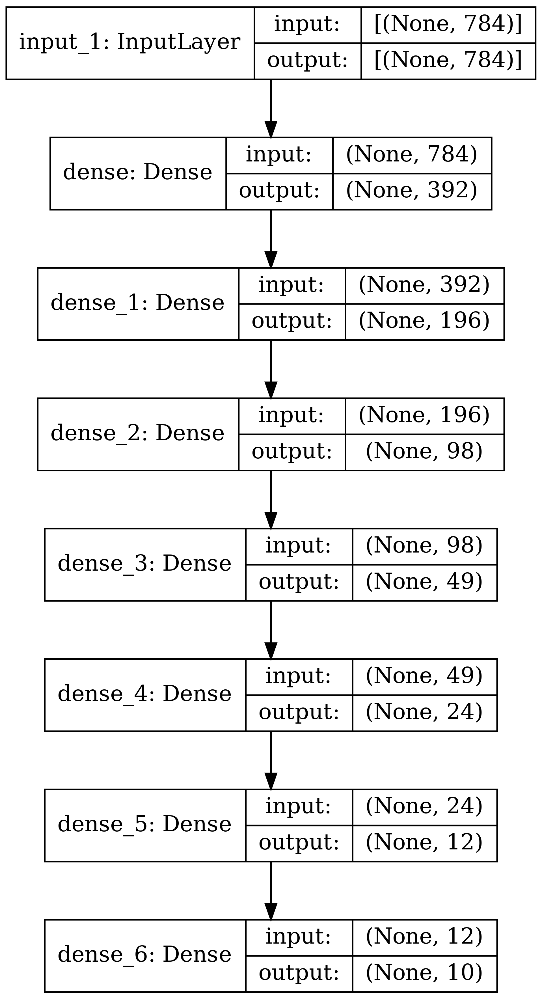

In [ ]:
keras.utils.plot_model(model, show_shapes=True,
                       dpi=400)

Getting the summary of the model architecture shape transformation and parameters:

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 392)               307720    
_________________________________________________________________
dense_1 (Dense)              (None, 196)               77028     
_________________________________________________________________
dense_2 (Dense)              (None, 98)                19306     
_________________________________________________________________
dense_3 (Dense)              (None, 49)                4851      
_________________________________________________________________
dense_4 (Dense)              (None, 24)                1200      
_________________________________________________________________
dense_5 (Dense)              (None, 12)                300       
_________________________________________________________________
dense_6 (Dense)              (None, 10)                1

Compiling and fitting the model:

In [ ]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
history = model.fit(x_train, y_train,
          validation_data=(x_val, y_val),
          epochs=1) # change this!

2022-02-27 03:53:07.546201: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


1875/1875 [==============================] - 12s 6ms/step - loss: 0.6702 - accuracy: 0.8353 - val_loss: 0.2377 - val_accuracy: 0.9395


Plotting model performance:

In [ ]:
# plt.figure(figsize=(10, 5), dpi=400)
# plt.plot(history.history['loss'], color='red', label='Training Loss', linestyle='--')
# plt.plot(history.history['val_loss'], color='blue', label='Validation Loss')
# plt.title('Model Performance')
# plt.xlabel('Epoch')
# plt.ylabel('Cross-Entropy')
# plt.legend()
# axes = plt.gca()
# axes.yaxis.grid()
# plt.show()

Let's evaluate how our programmatically generated architecture scales if we use it on larger (and more practical) images with shape `(200, 200)`.

In [ ]:
model = keras.models.Sequential()
curr_nodes = 200 * 200
model.add(L.Input((curr_nodes,)))
while curr_nodes > 20:
    curr_nodes = round(1/2 * curr_nodes)
    model.add(L.Dense(curr_nodes,
                      activation='relu'))
model.add(L.Dense(10, activation='softmax'))

Getting the summary of the model architecture shape transformation and parameters:

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 20000)             800020000 
_________________________________________________________________
dense_8 (Dense)              (None, 10000)             200010000 
_________________________________________________________________
dense_9 (Dense)              (None, 5000)              50005000  
_________________________________________________________________
dense_10 (Dense)             (None, 2500)              12502500  
_________________________________________________________________
dense_11 (Dense)             (None, 1250)              3126250   
_________________________________________________________________
dense_12 (Dense)             (None, 625)               781875    
_________________________________________________________________
dense_13 (Dense)             (None, 312)              

### The Convolution Operation

Let's generate a sample dummy image to apply different convolutions to:

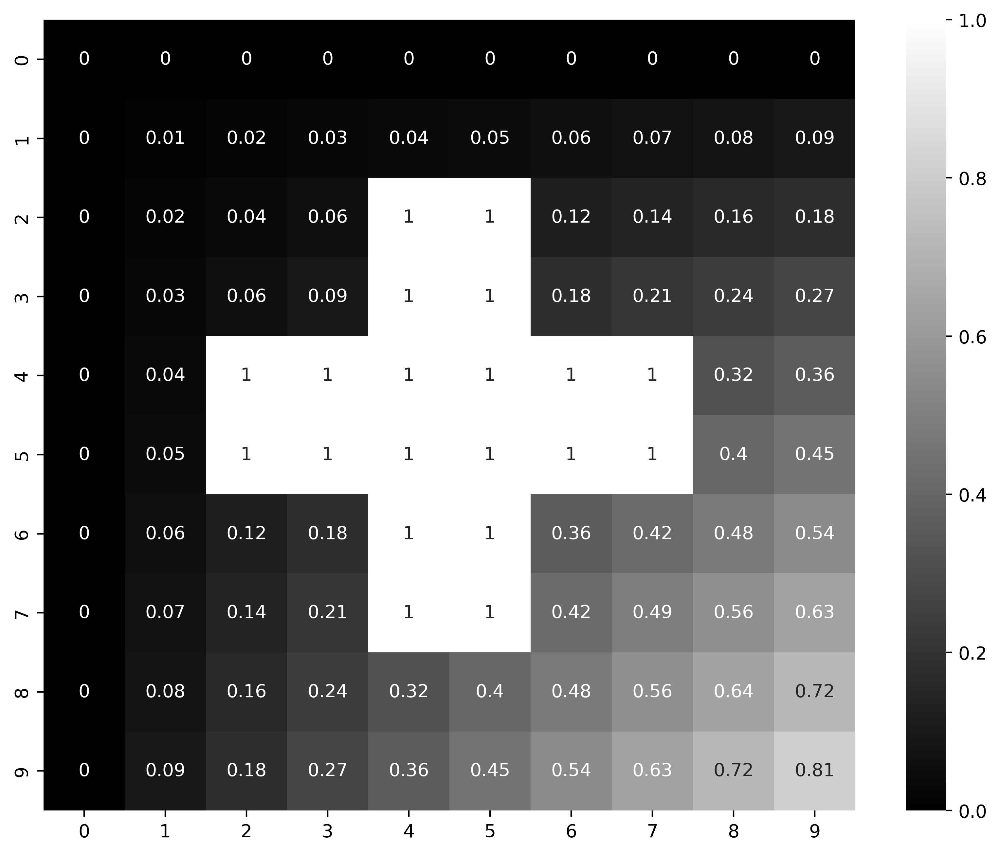

In [ ]:
img = np.zeros((10, 10))
for i in range(10):
    for j in range(10):
        img[i][j] = i * j / 100
        
for i in range(2, 8):
    for j in range(4, 6):
        img[i][j] = 1
        
for i in range(4, 6):
    for j in range(2, 8):
        img[i][j] = 1

plt.figure(figsize=(10, 8), dpi=400)
sns.heatmap(img, cmap='gray', annot = True)
plt.show()

Writing a function to apply an inputted kernel on the inputted image.

In [ ]:
def applyKernel(kernel, img):
    altered = cv2.filter2D(img, -1, kernel)
    plt.figure(figsize=(10, 8), dpi=400)
    sns.heatmap(altered, cmap='gray', annot = True)
    plt.show()

Applying an identity kernel:

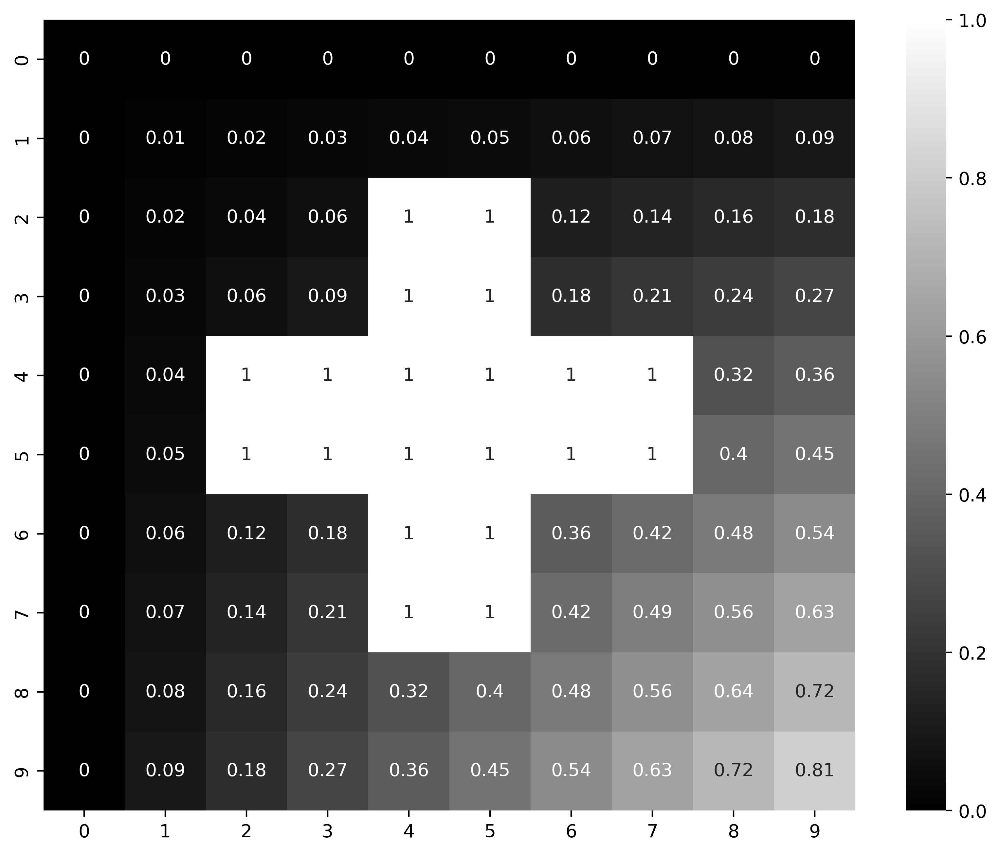

In [ ]:
kernel = np.array([[0, 0, 0],
                   [0, 1, 0],
                   [0, 0, 0]])

applyKernel(kernel, img)

Applying a $3\times 3$ uniform blurring kernel:

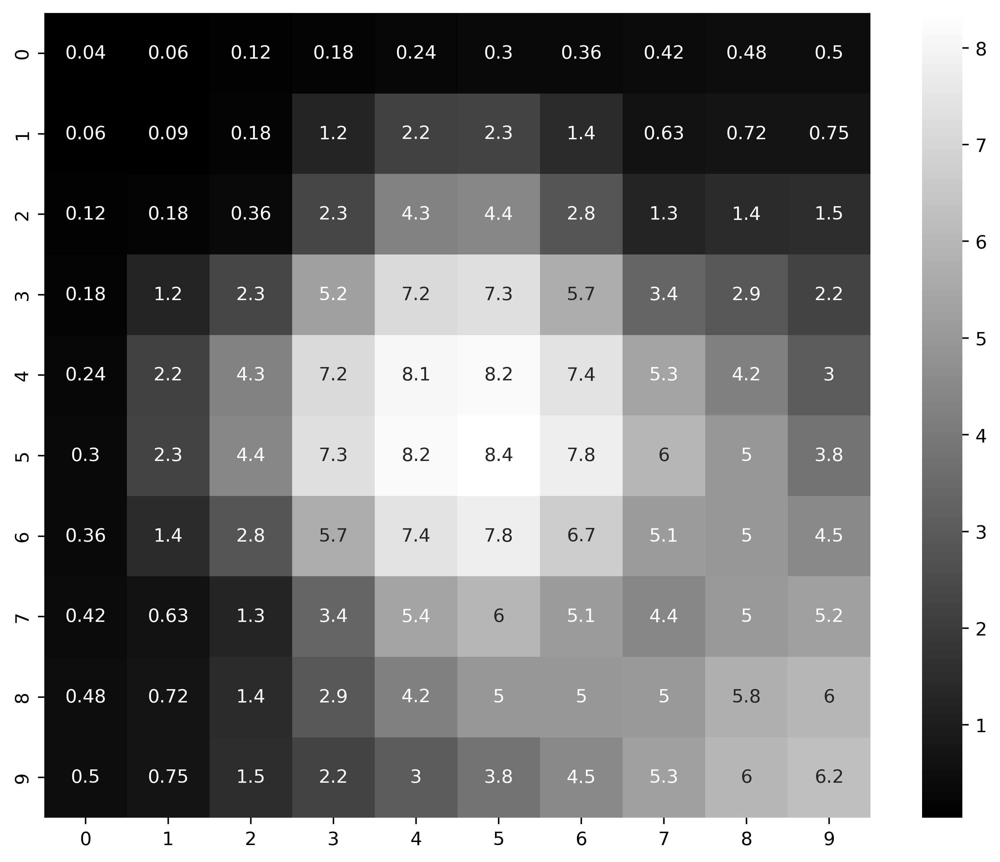

In [ ]:
kernel = np.ones((3, 3))

applyKernel(kernel, img)

Applying a $2\times 2$ uniform blurring kernel:

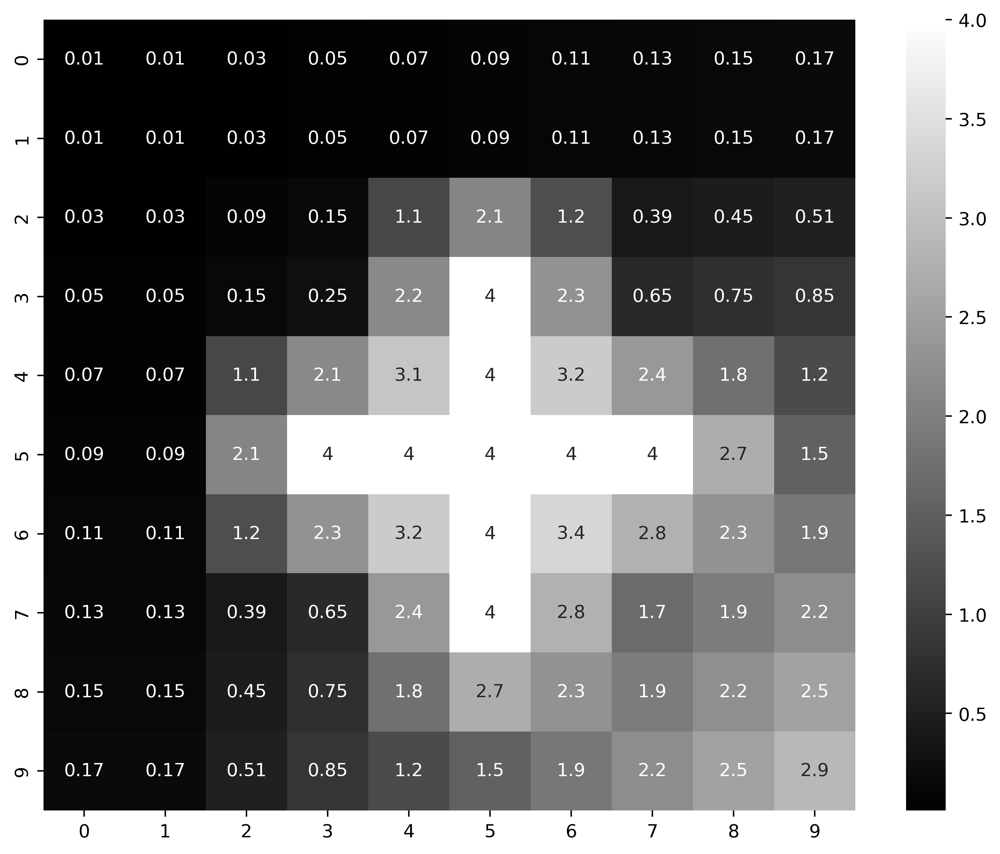

In [ ]:
kernel = np.ones((2, 2))

applyKernel(kernel, img)

Applying a $8\times 8$ uniform blurring kernel:

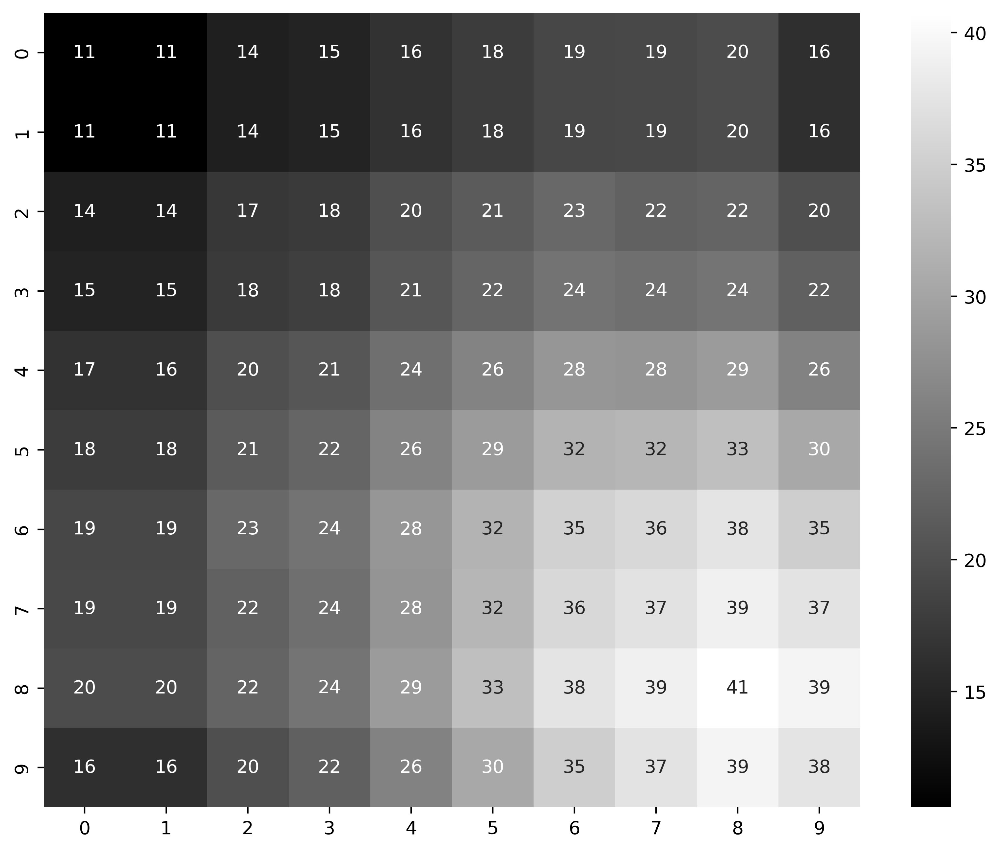

In [ ]:
kernel = np.ones((8, 8))

applyKernel(kernel, img)

Applying a $3\times 3$ sharpening kernel:

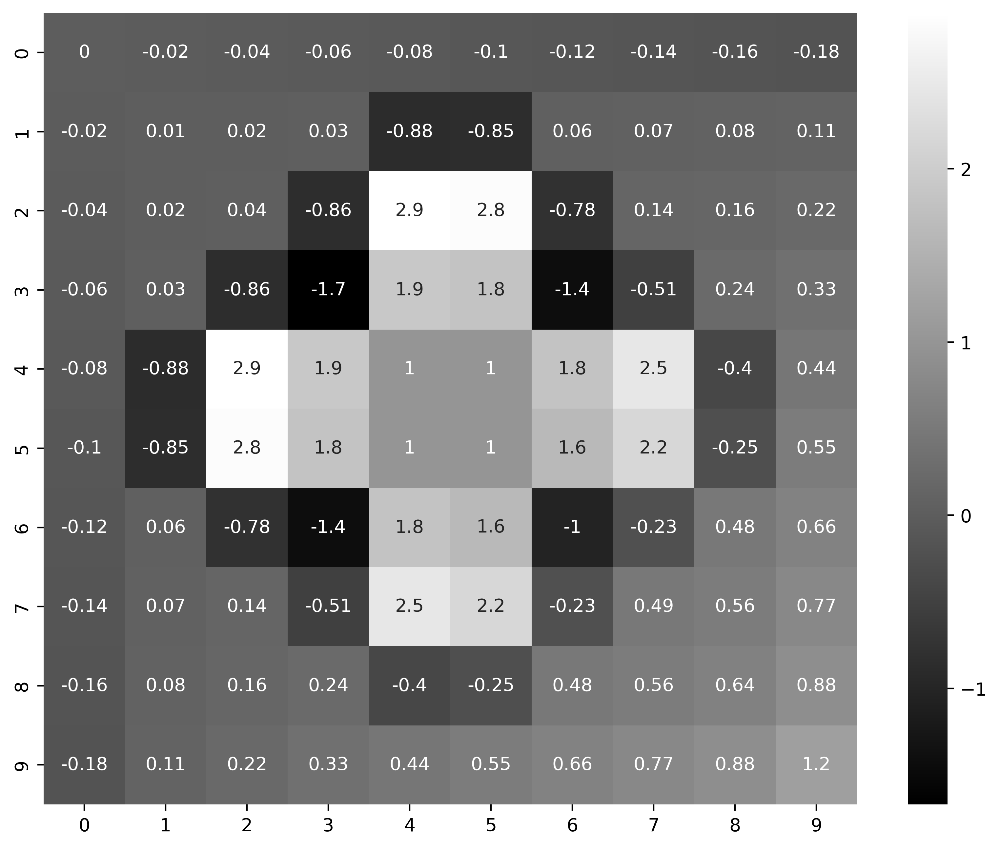

In [ ]:
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])

applyKernel(kernel, img)

Loading an image of a dog:

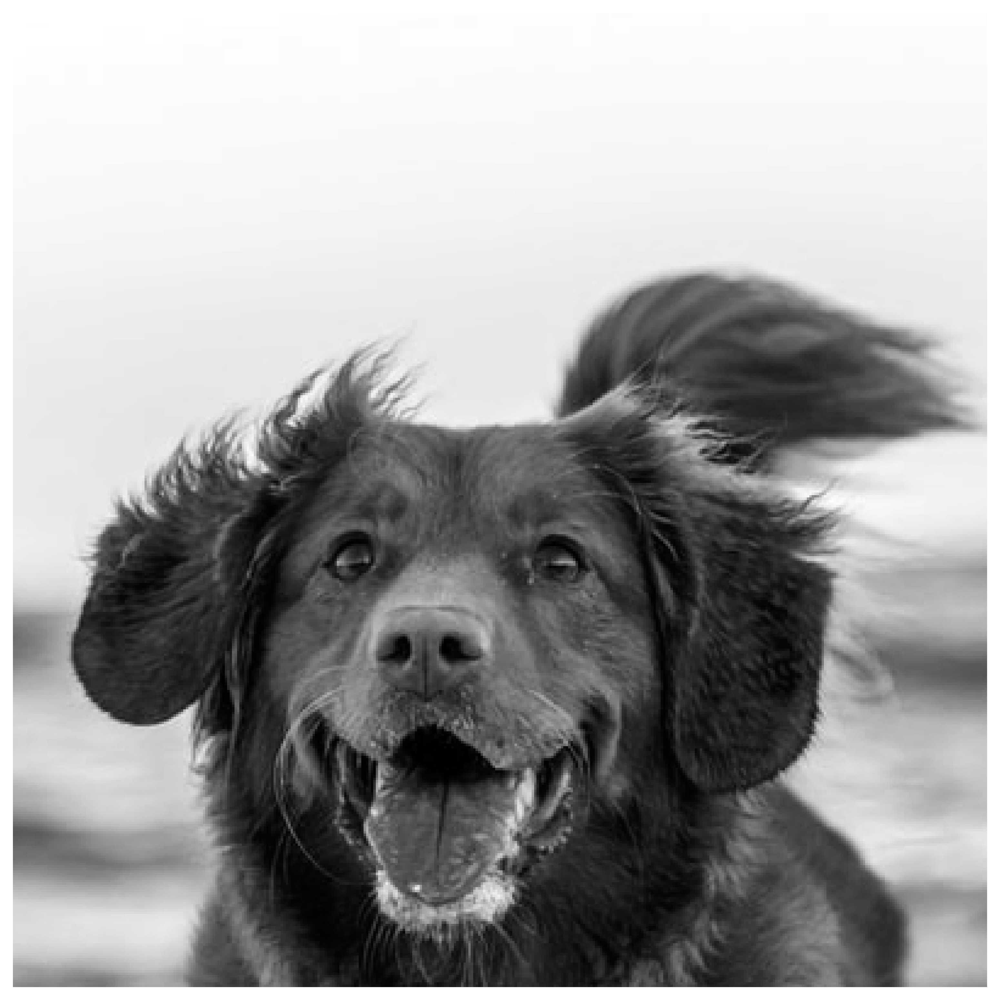

In [ ]:
url = 'https://images.unsplash.com/photo-1530281700549-e82e7bf110d6?ixlib=rb-1.2.1&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=988&q=80'
image = io.imread(url)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image = image[450:450+400, 250:250+400]

plt.figure(figsize=(10, 10), dpi=400)
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.show()

Writing a function to apply and display a kernel to an image.

In [ ]:
def applyKernel(kernel, img):
    altered = cv2.filter2D(img, -1, kernel)
    plt.figure(figsize=(8, 8), dpi=400)
    plt.imshow(altered, cmap='gray')
    plt.axis('off')
    plt.show()

Erroneously applying a 3-by-3 uniform blurring kernel:

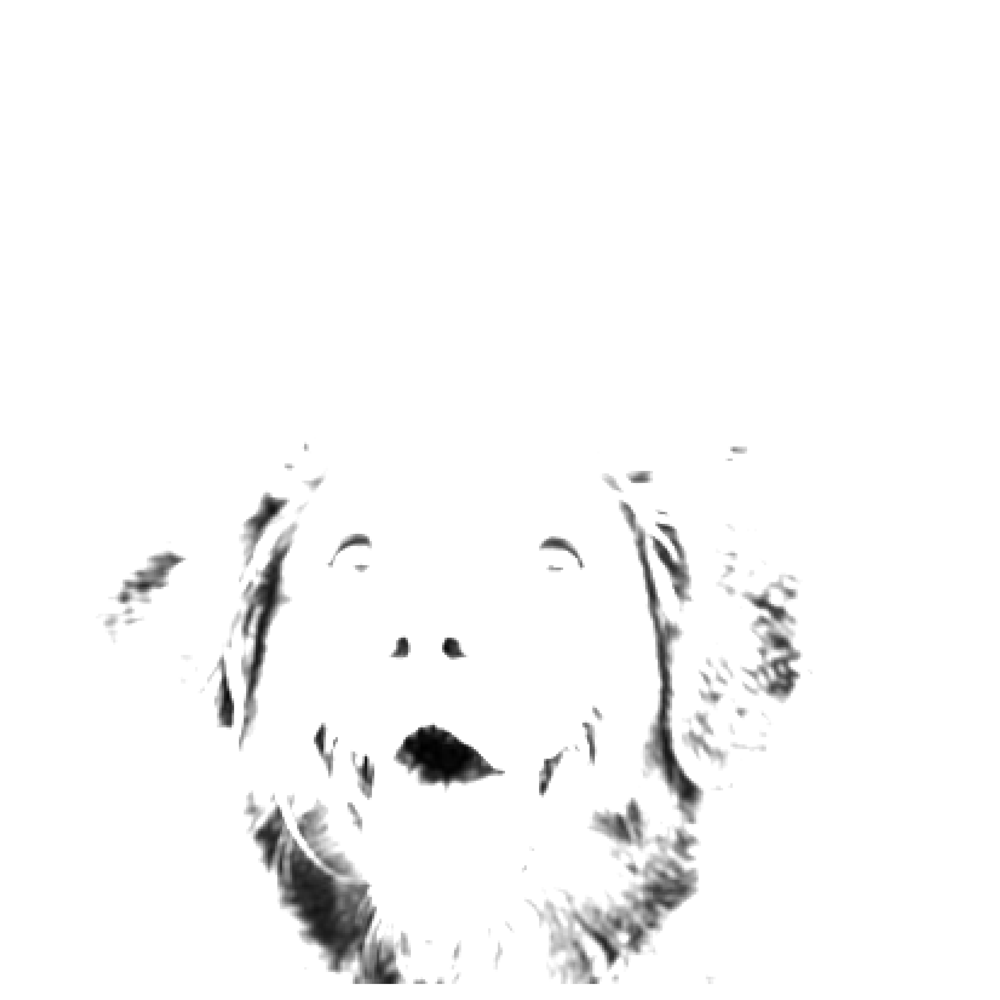

In [ ]:
kernel = np.ones((3, 3))
applyKernel(kernel, image)

Distribution of values for an erroneously applied 3-by-3 uniform blurring kernel.

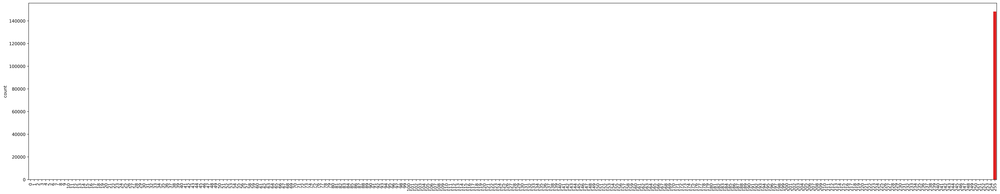

In [ ]:
plt.figure(figsize=(40, 7.5), dpi = 400)
sns.countplot(x=cv2.filter2D(image, -1, kernel).flatten(), color='red')
plt.xticks(rotation=90)
plt.show()

Original distribution of values in image.

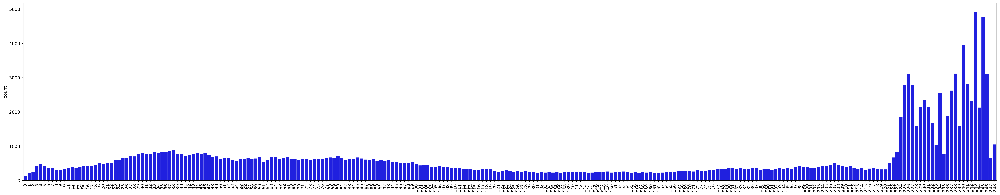

In [ ]:
plt.figure(figsize=(40, 7.5), dpi = 400)
sns.countplot(x=image.flatten(), color='blue')
plt.xticks(rotation=90)
plt.show()

Correctly applying a 3-by-3 uniform blurring kernel.

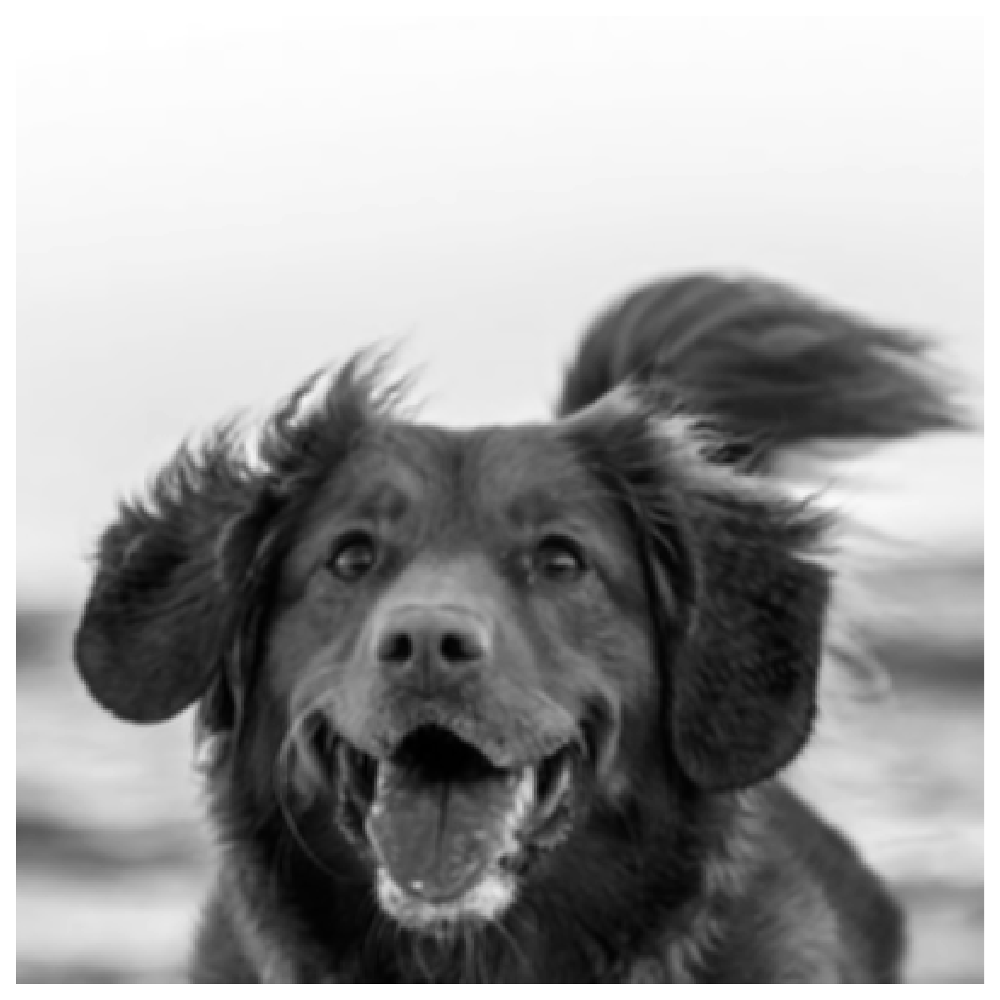

In [ ]:
kernel = np.ones((3, 3))/9
applyKernel(kernel, image)

Distribution of values for a correctly applied 3-by-3 uniform blurring kernel.

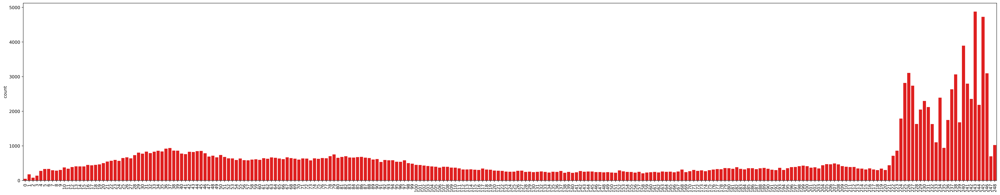

In [ ]:
plt.figure(figsize=(40, 7.5), dpi = 400)
sns.countplot(x=cv2.filter2D(image, -1, kernel).flatten(), color='red')
plt.xticks(rotation=90)
plt.show()

Applying an 8-by-8 blurring kernel:

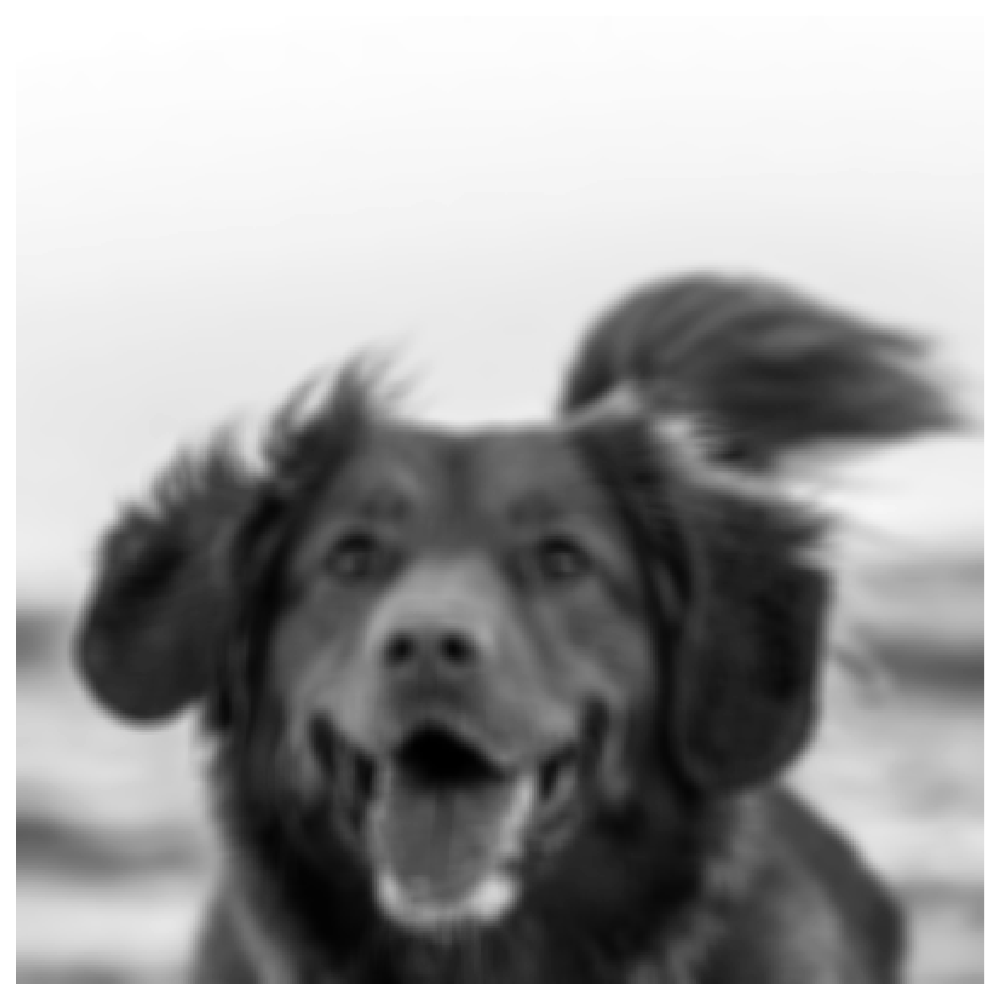

In [ ]:
kernel = np.ones((8, 8))/64
applyKernel(kernel, image)

Applying a sharpening kernel:

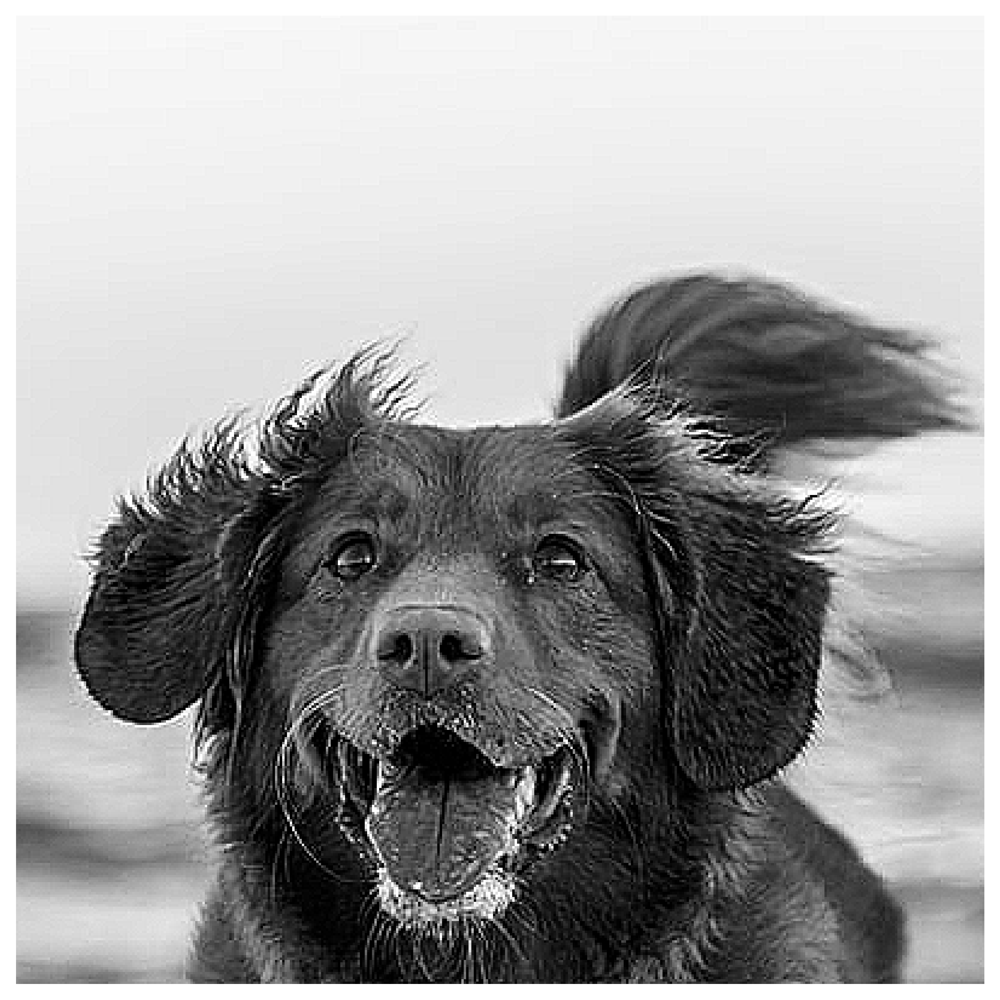

In [ ]:
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])
applyKernel(kernel, image)

Building a convolutional neural network approach to modeling the MNIST dataset.

In [ ]:
import keras.layers as L
from keras.models import Sequential
model = Sequential()
model.add(L.Input((28, 28, 1)))
model.add(L.Conv2D(8, (5, 5), activation='relu'))
model.add(L.Conv2D(8, (3, 3), activation='relu'))
model.add(L.Conv2D(16, (3, 3), activation='relu'))
model.add(L.Conv2D(16, (2, 2), activation='relu'))

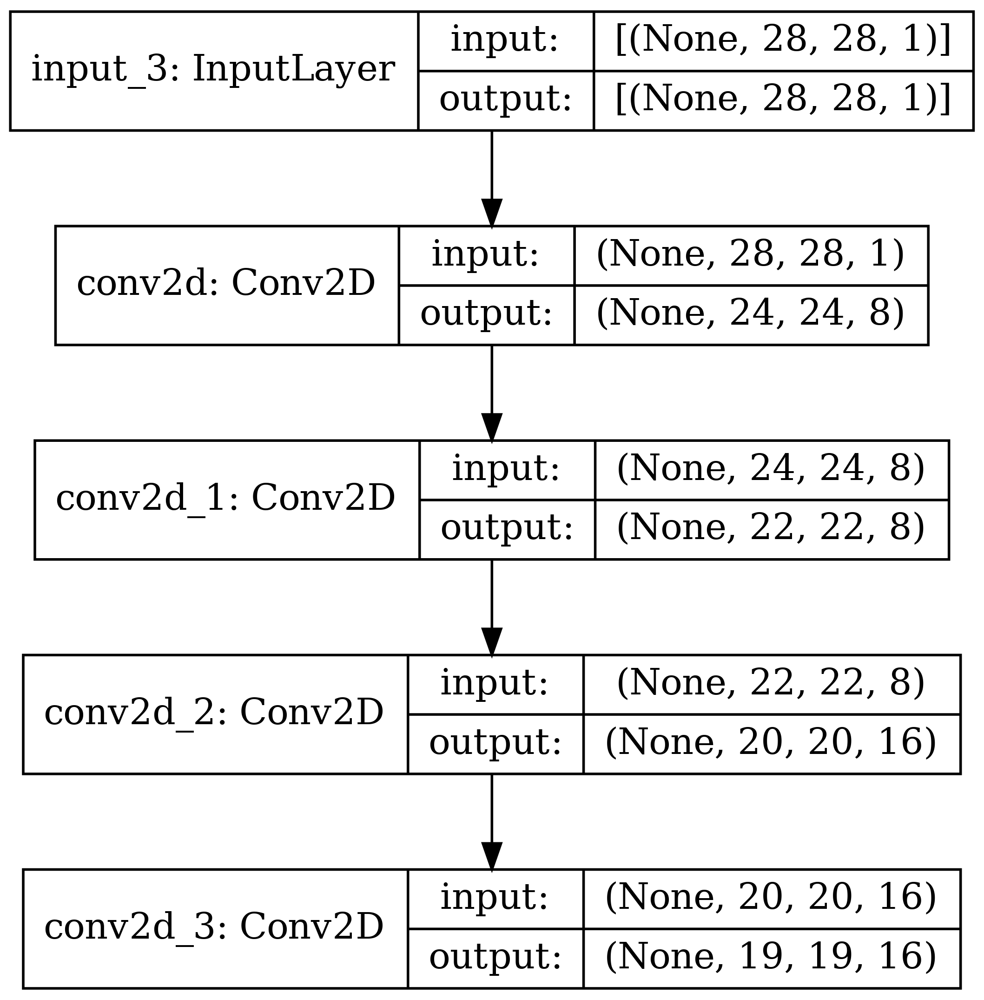

In [ ]:
keras.utils.plot_model(model, show_shapes=True,
                       dpi=400)

In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 24, 24, 8)         208       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 22, 22, 8)         584       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 20, 20, 16)        1168      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 19, 19, 16)        1040      
Total params: 3,000
Trainable params: 3,000
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model.add(L.Flatten())
model.add(L.Dense(32, activation='relu'))
model.add(L.Dense(16, activation='relu'))
model.add(L.Dense(10, activation='softmax'))

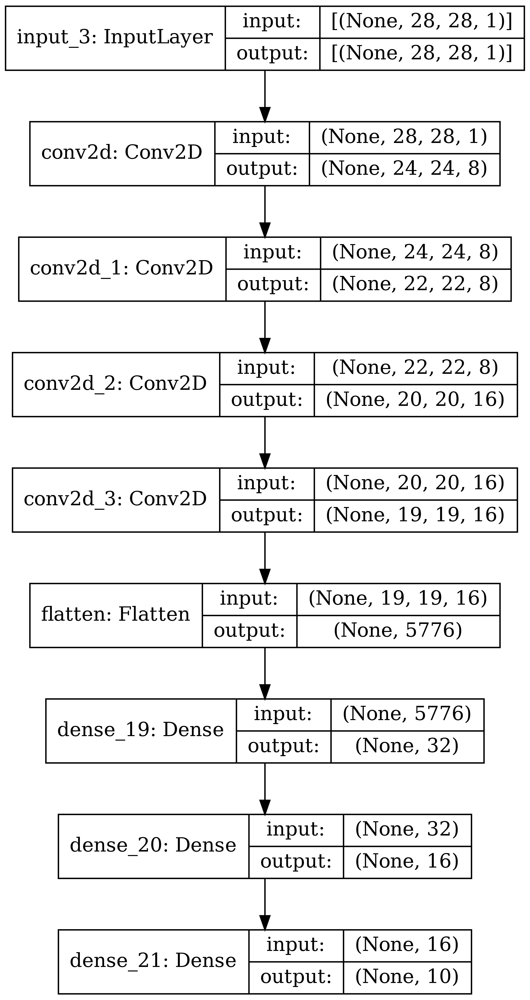

In [ ]:
keras.utils.plot_model(model, show_shapes=True,
                       dpi=400)

In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 24, 24, 8)         208       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 22, 22, 8)         584       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 20, 20, 16)        1168      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 19, 19, 16)        1040      
_________________________________________________________________
flatten (Flatten)            (None, 5776)              0         
_________________________________________________________________
dense_19 (Dense)             (None, 32)                184864    
_________________________________________________________________
dense_20 (Dense)             (None, 16)               

Let's reload the MNIST data.

In [ ]:
(x_train, y_train), (x_val, y_val) = load_mnist()
x_train = x_train.reshape((len(x_train), 28, 28, 1))
x_val = x_val.reshape((len(x_val), 28, 28, 1))

Compiling and fitting:

In [ ]:
model.compile(optimizer = 'adam',
              loss = 'sparse_categorical_crossentropy',
              metrics = ['accuracy'])
history = model.fit(x_train, y_train, epochs = 1, # change this
                    validation_data = (x_val, y_val))

1875/1875 [==============================] - 20s 10ms/step - loss: 0.3256 - accuracy: 0.9038 - val_loss: 0.1013 - val_accuracy: 0.9694


Plotting history:

In [ ]:
# plt.figure(figsize=(20, 7.5), dpi=400)
# plt.plot(history.history['loss'], color='red', 
#          label='Train')
# plt.plot(history.history['val_loss'],
#          color='blue', linestyle='--',
#          label='Validation')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.title('Loss over Epochs')
# plt.legend()
# plt.grid()
# plt.show()

# plt.figure(figsize=(20, 7.5), dpi=400)
# plt.plot(history.history['accuracy'], color='red', 
#          label='Train')
# plt.plot(history.history['val_accuracy'], 
#     color='blue', linestyle='--',
#          label='Validation')
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy')
# plt.title('Accuracy over Epochs')
# plt.legend()
# plt.grid()
# plt.show()

Plotting out the learned representations from the first layer of the network. (This'll look like nonsense if the network is not sufficiently trained.)

In [ ]:
peek = Sequential()
peek.add(L.Input((28, 28, 1)))
peek.add(model.layers[0])

NUM_IMAGES = 8
GRAPHIC_WIDTH = 8

plt.figure(figsize=(40, 40), dpi=400)
for index in range(NUM_IMAGES):
    peek_out = peek.predict(x_train[index].reshape((1, 28, 28, 1)))[0]
    plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+1)
    plt.imshow(x_train[index], cmap='gray')
    plt.axis('off')
    for i in range(GRAPHIC_WIDTH - 1):
        plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+i+2)
        plt.imshow(peek_out[:,:,i], cmap='gray')
        plt.axis('off')
plt.show()

Incorporating the second layer:

In [ ]:
peek.add(model.layers[1])

plt.figure(figsize=(40, 40), dpi=400)
for index in range(NUM_IMAGES):
    peek_out = peek.predict(x_train[index].reshape((1, 28, 28, 1)))[0]
    plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+1)
    plt.imshow(x_train[index], cmap='gray')
    plt.axis('off')
    for i in range(GRAPHIC_WIDTH - 1):
        plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+i+2)
        plt.imshow(peek_out[:,:,i], cmap='gray')
        plt.axis('off')
plt.show()

Incorporating the third layer:

In [ ]:
peek.add(model.layers[2])

plt.figure(figsize=(40, 40), dpi=400)
for index in range(NUM_IMAGES):
    peek_out = peek.predict(x_train[index].reshape((1, 28, 28, 1)))[0]
    plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+1)
    plt.imshow(x_train[index], cmap='gray')
    plt.axis('off')
    for i in range(GRAPHIC_WIDTH - 1):
        plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+i+2)
        plt.imshow(peek_out[:,:,i], cmap='gray')
        plt.axis('off')
plt.show()

Incorporating the fourth layer:

In [ ]:
peek.add(model.layers[3])

plt.figure(figsize=(40, 40), dpi=400)
for index in range(NUM_IMAGES):
    peek_out = peek.predict(x_train[index].reshape((1, 28, 28, 1)))[0]
    plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+1)
    plt.imshow(x_train[index], cmap='gray')
    plt.axis('off')
    for i in range(GRAPHIC_WIDTH - 1):
        plt.subplot(NUM_IMAGES, GRAPHIC_WIDTH, index*GRAPHIC_WIDTH+i+2)
        plt.imshow(peek_out[:,:,i], cmap='gray')
        plt.axis('off')
plt.show()

### The Pooling Operation

Observing the parametrization scaling of a standard CNN design:

  0%|          | 0/33 [00:00<?, ?it/s]

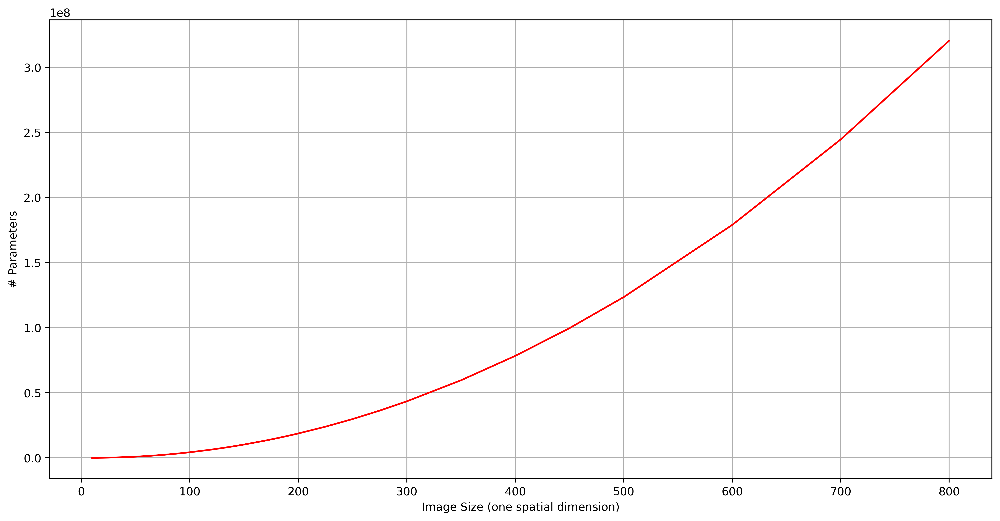

In [ ]:
def build_model(img_size):
    model = Sequential()
    model.add(L.Input((img_size, img_size, 1)))
    model.add(L.Conv2D(8, (5, 5), activation='relu'))
    model.add(L.Conv2D(8, (3, 3), activation='relu'))
    model.add(L.Conv2D(16, (3, 3), activation='relu'))
    model.add(L.Conv2D(16, (2, 2), activation='relu'))
    model.add(L.Flatten())
    model.add(L.Dense(32, activation='relu'))
    model.add(L.Dense(16, activation='relu'))
    model.add(L.Dense(10, activation='softmax'))
    paramCount = model.count_params()
    del model
    return paramCount

x = [10, 15, 20, 25, 30, 35, 40, 45, 50, 
     60, 70, 80, 90, 100, 120, 130, 140, 150,
     170, 180, 190, 200, 225, 250, 275, 300,
     350, 400, 450, 500, 600, 700, 800]
y = [build_model(i) for i in tqdm(x)]

plt.figure(figsize=(15, 7.5), dpi=400)
plt.plot(x, y, color='red')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Parameters')
plt.grid()
plt.show()

Observing the parametrization and layer scaling of a 'self-extending' CNN design:

  0%|          | 0/33 [00:00<?, ?it/s]

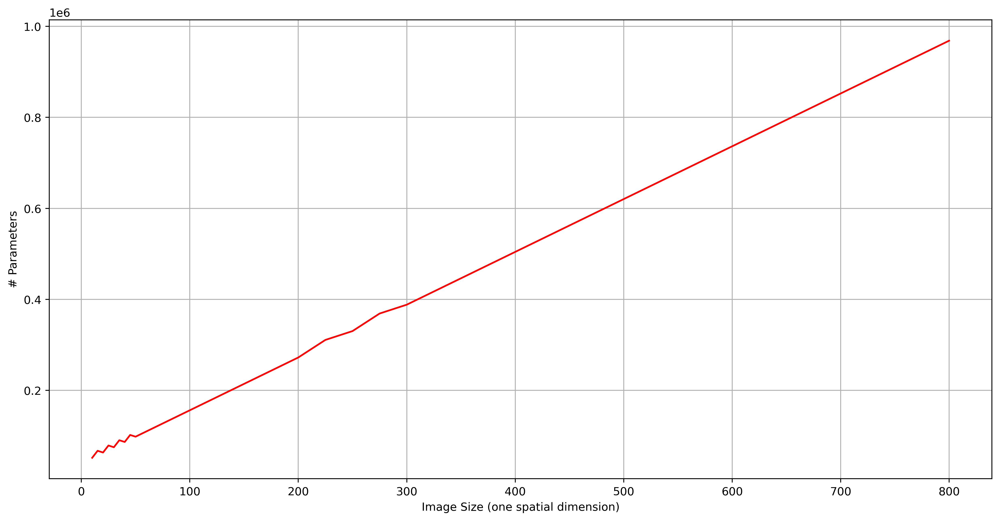

In [ ]:
def build_model(img_size):
    
    model = Sequential()
    model.add(L.Input((img_size, img_size, 1)))
    model.add(L.Conv2D(16, (1, 1), activation='relu'))
    featureMapSize = img_size
    while (featureMapSize ** 2) * 16 > 2048:
        model.add(L.Conv2D(16, (3, 3), activation='relu'))
        featureMapSize -= 2
    model.add(L.Flatten())
    model.add(L.Dense(32, activation='relu'))
    model.add(L.Dense(16, activation='relu'))
    model.add(L.Dense(10, activation='softmax'))
    
    paramCount = model.count_params()
    del model
    return paramCount

x = [10, 15, 20, 25, 30, 35, 40, 45, 50, 
     60, 70, 80, 90, 100, 120, 130, 140, 150,
     170, 180, 190, 200, 225, 250, 275, 300,
     350, 400, 450, 500, 600, 700, 800]
y = [build_model(i) for i in tqdm(x)]

plt.figure(figsize=(15, 7.5), dpi=400)
plt.plot(x, y, color='red')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Parameters')
plt.grid()
plt.show()

  0%|          | 0/33 [00:00<?, ?it/s]

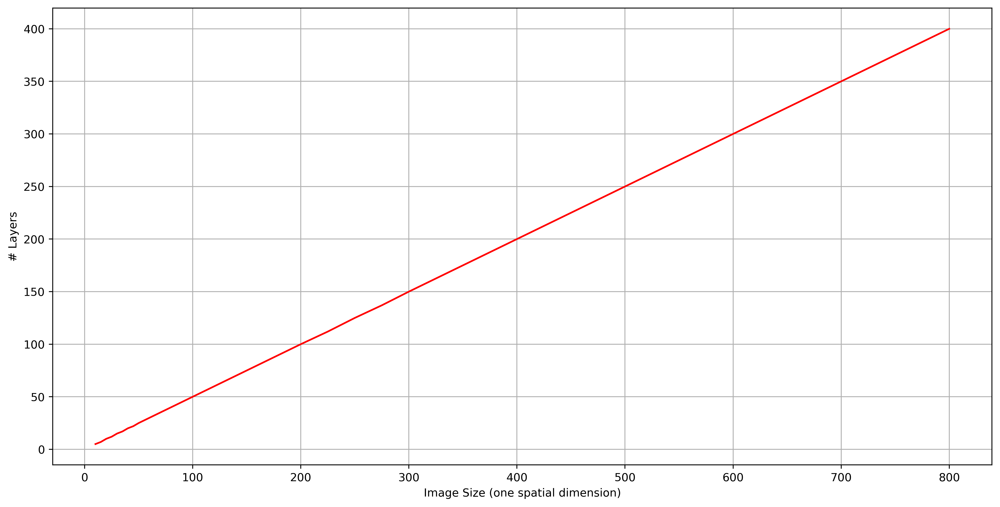

In [ ]:
def build_model(img_size):
    
    model = Sequential()
    model.add(L.Input((img_size, img_size, 1)))
    model.add(L.Conv2D(16, (1, 1), activation='relu'))
    featureMapSize = img_size
    while (featureMapSize ** 2) * 16 > 2048:
        model.add(L.Conv2D(16, (3, 3), activation='relu'))
        featureMapSize -= 2
    model.add(L.Flatten())
    model.add(L.Dense(32, activation='relu'))
    model.add(L.Dense(16, activation='relu'))
    model.add(L.Dense(10, activation='softmax'))
    
    layerCount = len(model.layers)
    del model
    return layerCount

x = [10, 15, 20, 25, 30, 35, 40, 45, 50, 
     60, 70, 80, 90, 100, 120, 130, 140, 150,
     170, 180, 190, 200, 225, 250, 275, 300,
     350, 400, 450, 500, 600, 700, 800]
y = [build_model(i) for i in tqdm(x)]

plt.figure(figsize=(15, 7.5), dpi=400)
plt.plot(x, y, color='red')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Layers')
plt.grid()
plt.show()

Reloading our sample image:

In [ ]:
img = np.zeros((10, 10))
for i in range(10):
    for j in range(10):
        img[i][j] = i * j / 100
        
for i in range(2, 8):
    for j in range(4, 6):
        img[i][j] = 1
        
for i in range(4, 6):
    for j in range(2, 8):
        img[i][j] = 1

Applying 2-by-2 mean pooling to the image:

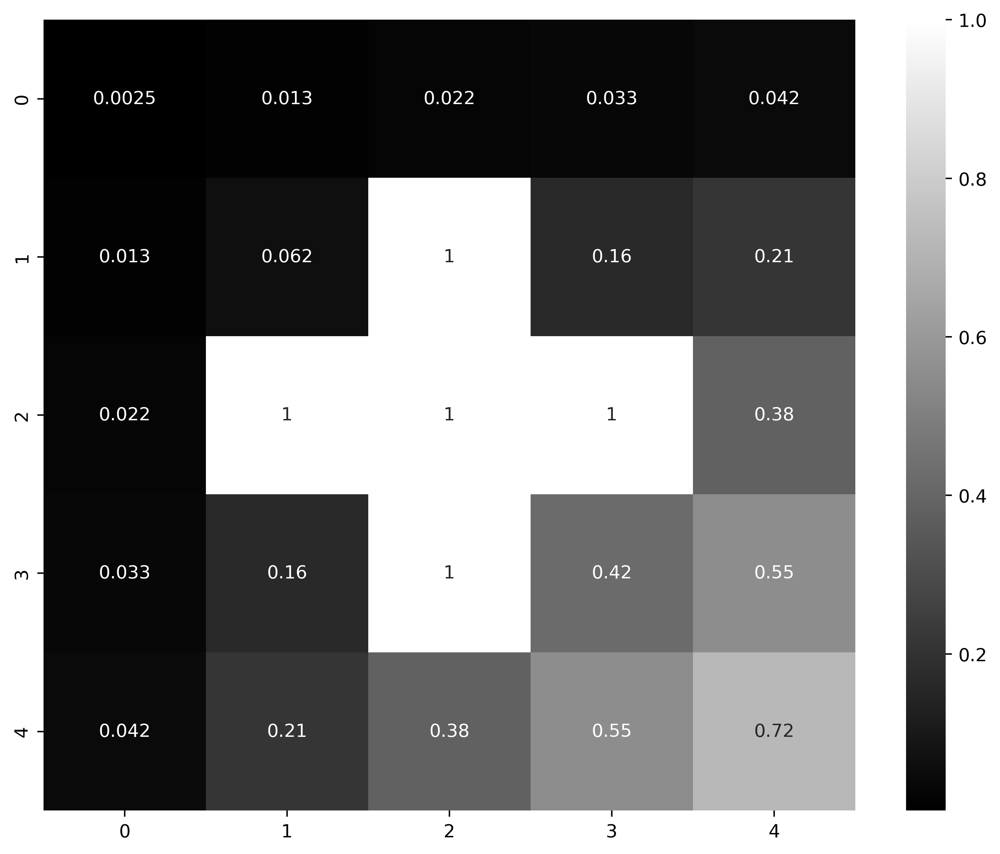

In [ ]:
import skimage.measure
pooled = skimage.measure.block_reduce(img, (2,2), np.mean)

plt.figure(figsize=(10, 8), dpi=400)
sns.heatmap(pooled, cmap='gray', annot = True)
plt.show()

Applying 2-by-2 max pooling to the image:

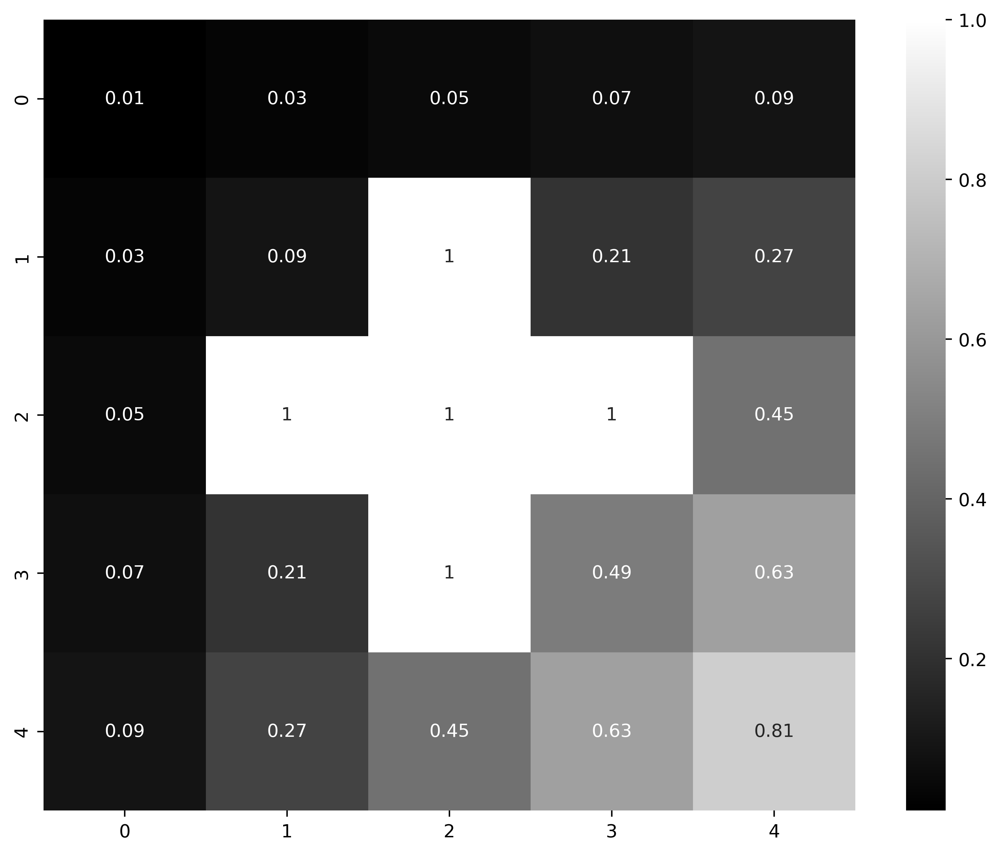

In [ ]:
pooled = skimage.measure.block_reduce(img, (2,2), np.max)
plt.figure(figsize=(10, 8), dpi=400)
sns.heatmap(pooled, cmap='gray', annot = True)
plt.show()

Applying 2-by-2 mean pooling, twice.

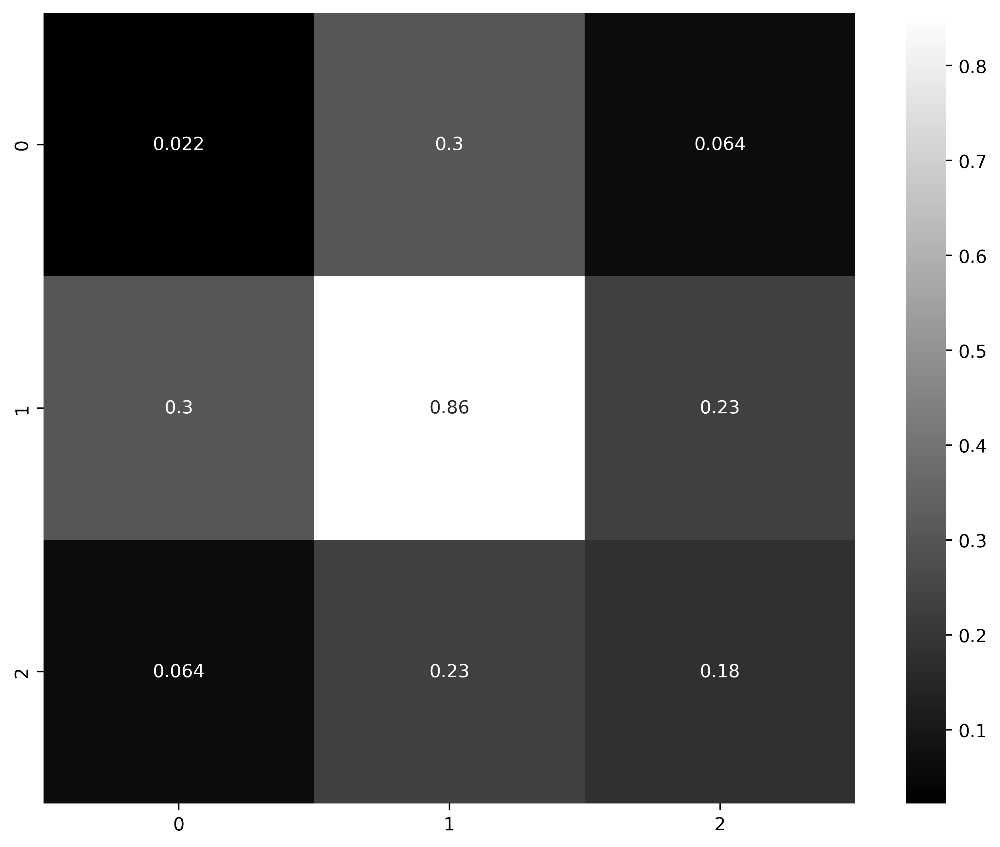

In [ ]:
pooled = skimage.measure.block_reduce(img, (2,2), np.mean)
pooled2 = skimage.measure.block_reduce(pooled, (2,2), np.mean)

plt.figure(figsize=(10, 8), dpi=400)
sns.heatmap(pooled2, cmap='gray', annot = True)
plt.show()

Applying 2-by-2 max pooling, twice.

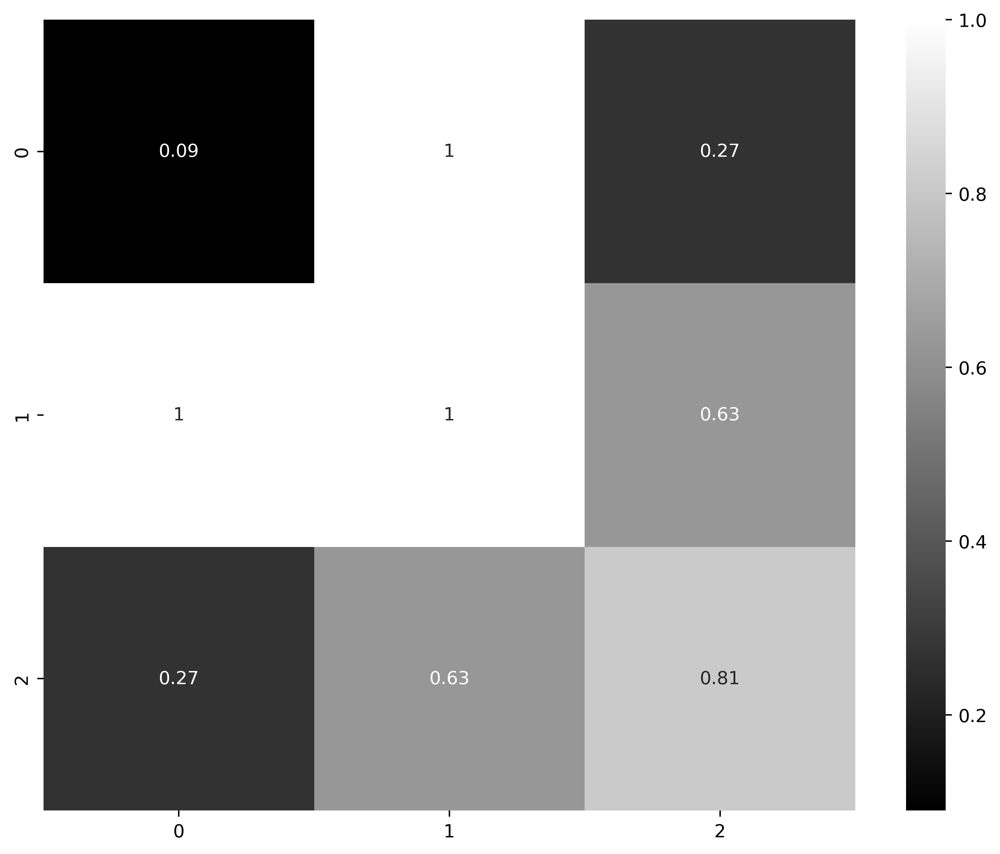

In [ ]:
pooled = skimage.measure.block_reduce(img, (2,2), np.max)
pooled2 = skimage.measure.block_reduce(pooled, (2,2), np.max)

plt.figure(figsize=(10, 8), dpi=400)
sns.heatmap(pooled2, cmap='gray', annot = True)
plt.show()

Building a network with a pooling layer:

  0%|          | 0/31 [00:00<?, ?it/s]

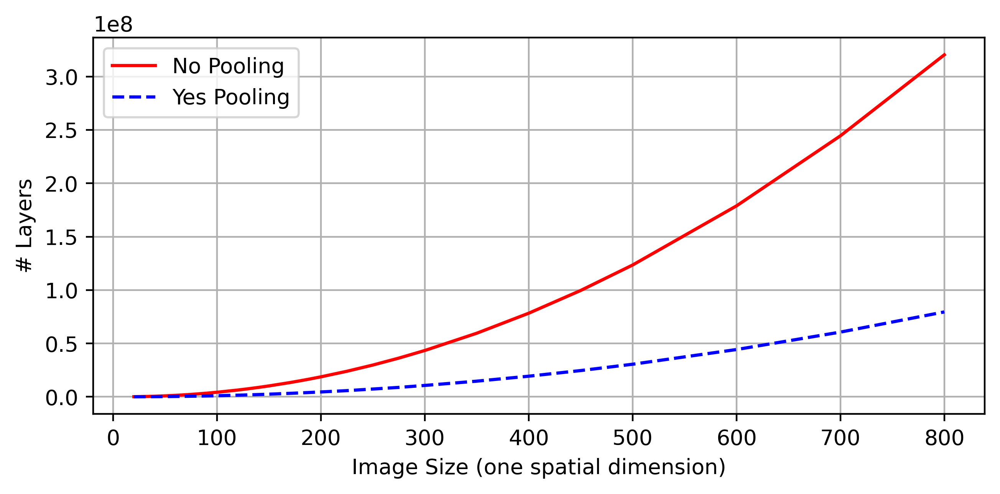

In [ ]:
from keras.models import Sequential

def build_model(img_size):
    inp = L.Input((img_size, img_size, 1))
    x = L.Conv2D(8, (5, 5), activation='relu')(inp)
    prev = L.Conv2D(8, (3, 3), activation='relu')(x)
    pool = L.MaxPooling2D((2, 2))(prev)
    after = L.Conv2D(16, (3, 3), activation='relu')(pool)
    x = L.Conv2D(16, (2, 2), activation='relu')(after)
    x = L.Flatten()(x)
    x = L.Dense(32, activation='relu')(x)
    x = L.Dense(16, activation='relu')(x)
    x = L.Dense(10, activation='softmax')(x)
    model = keras.models.Model(inputs = inp, outputs = x)

    yesPoolingParamCount = model.count_params()

    after = L.Conv2D(16, (3, 3), activation='relu')(prev)
    x = L.Conv2D(16, (2, 2), activation='relu')(after)
    x = L.Flatten()(x)
    x = L.Dense(32, activation='relu')(x)
    x = L.Dense(16, activation='relu')(x)
    x = L.Dense(10, activation='softmax')(x)
    model = keras.models.Model(inputs = inp, outputs = x)
    
    noPoolingParamCount = model.count_params()
    
    del model
    
    return noPoolingParamCount, yesPoolingParamCount

x = [20, 25, 30, 35, 40, 45, 50, 
     60, 70, 80, 90, 100, 120, 130, 140, 150,
     170, 180, 190, 200, 225, 250, 275, 300,
     350, 400, 450, 500, 600, 700, 800]
y = [build_model(i) for i in tqdm(x)]

plt.figure(figsize=(7.5, 3.25), dpi=400)
plt.plot(x, [i for i, j in y], color='red', label='No Pooling')
plt.plot(x, [j for i, j in y], color='blue', label='Yes Pooling', linestyle='--')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Layers')
plt.grid()
plt.legend()
plt.show()

  0%|          | 0/31 [00:00<?, ?it/s]

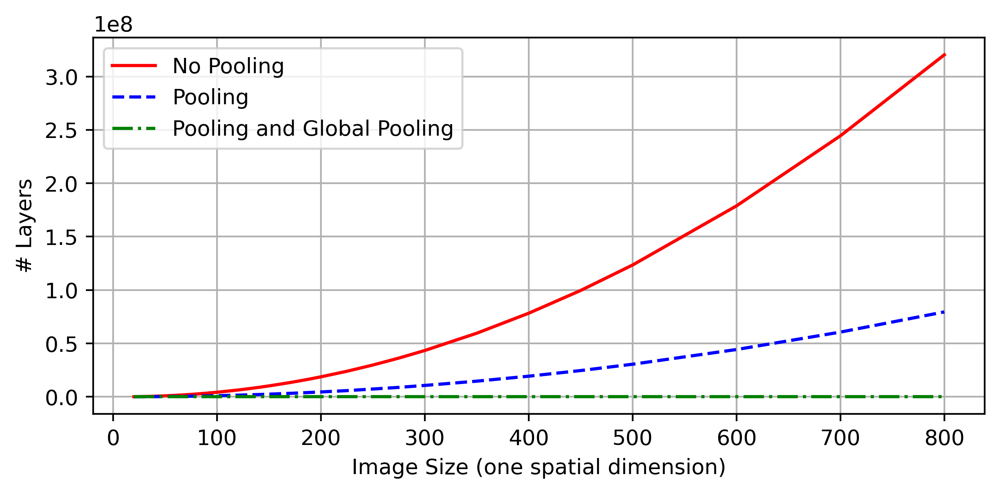

In [ ]:
def build_pooling_model(img_size):
    inp = L.Input((img_size, img_size, 1))
    x = L.Conv2D(8, (5, 5), activation='relu')(inp)
    prev = L.Conv2D(8, (3, 3), activation='relu')(x)
    pool = L.MaxPooling2D((2, 2))(prev)
    after = L.Conv2D(16, (3, 3), activation='relu')(pool)
    x = L.Conv2D(16, (2, 2), activation='relu')(after)
    x = L.GlobalAveragePooling2D()(x)
    x = L.Dense(32, activation='relu')(x)
    x = L.Dense(16, activation='relu')(x)
    x = L.Dense(10, activation='softmax')(x)
    model = keras.models.Model(inputs = inp, outputs = x)
    paramCounts = model.count_params()
    del model
    return paramCounts

x = [20, 25, 30, 35, 40, 45, 50, 
     60, 70, 80, 90, 100, 120, 130, 140, 150,
     170, 180, 190, 200, 225, 250, 275, 300,
     350, 400, 450, 500, 600, 700, 800]
yPool = [build_pooling_model(i) for i in tqdm(x)]

plt.figure(figsize=(7.5, 3.25), dpi=400)
plt.plot(x, [i for i, j in y], color='red', label='No Pooling')
plt.plot(x, [j for i, j in y], color='blue', label='Pooling', linestyle='--')
plt.plot(x, yPool, color='green', label='Pooling and Global Pooling', linestyle='-.')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Layers')
plt.grid()
plt.legend()
plt.show()

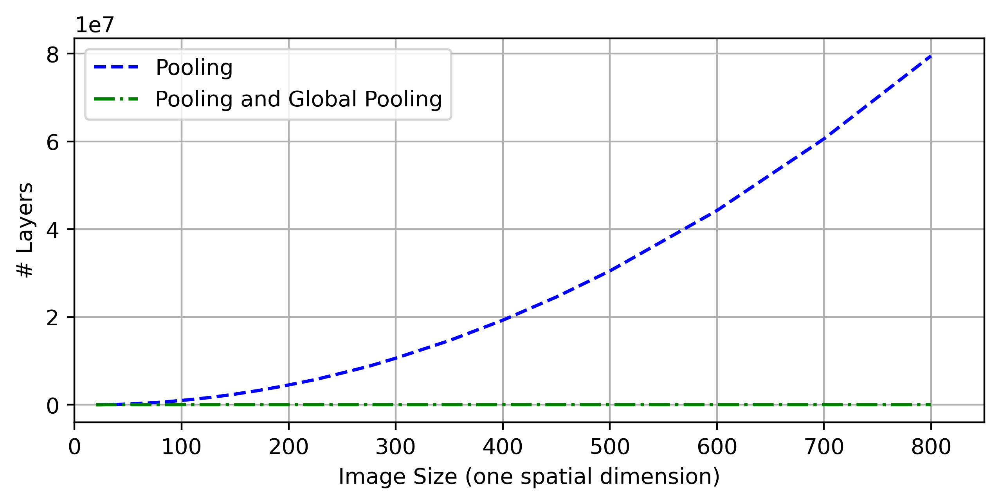

In [ ]:
plt.figure(figsize=(7.5, 3.25), dpi=400)
plt.plot(x, [j for i, j in y], color='blue', label='Pooling', linestyle='--')
plt.plot(x, yPool, color='green', label='Pooling and Global Pooling', linestyle='-.')
plt.xlabel('Image Size (one spatial dimension)')
plt.ylabel('# Layers')
plt.xlim(0, 850)
plt.grid()
plt.legend()
plt.show()

Implementing the AlexNet architecture:

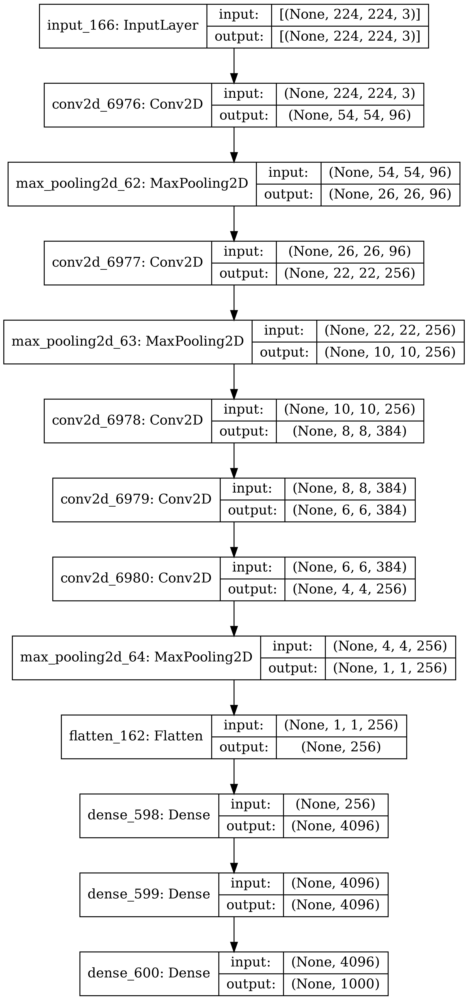

In [ ]:
model = Sequential()
model.add(L.Input((224, 224, 3)))
model.add(L.Conv2D(96, (11, 11), strides=4))
model.add(L.MaxPooling2D((3, 3), strides=2))
model.add(L.Conv2D(256, (5, 5), padding='valid'))
model.add(L.MaxPooling2D((3, 3), strides=2))
model.add(L.Conv2D(384, (3, 3), padding='valid'))
model.add(L.Conv2D(384, (3, 3), padding='valid'))
model.add(L.Conv2D(256, (3, 3), padding='valid'))
model.add(L.MaxPooling2D((3, 3), strides=2))
model.add(L.Flatten())
model.add(L.Dense(4096, activation='relu'))
model.add(L.Dense(4096, activation='relu'))
model.add(L.Dense(1000, activation='softmax'))

keras.utils.plot_model(model, show_shapes=True, dpi=400)

---

## Base CNN Architectures

In [ ]:
a, b, c = 224, 224, 10

Instantiating a single model:

In [ ]:
from tensorflow.keras.applications import ResNet50
model = ResNet50(input_shape = (a, b, 3),
                 classes = c,
                 weights = None)
# model.compile(…)
# model.fit(…)

Using models as components or submodels of an overarching models with an example hybrid ResNet model:

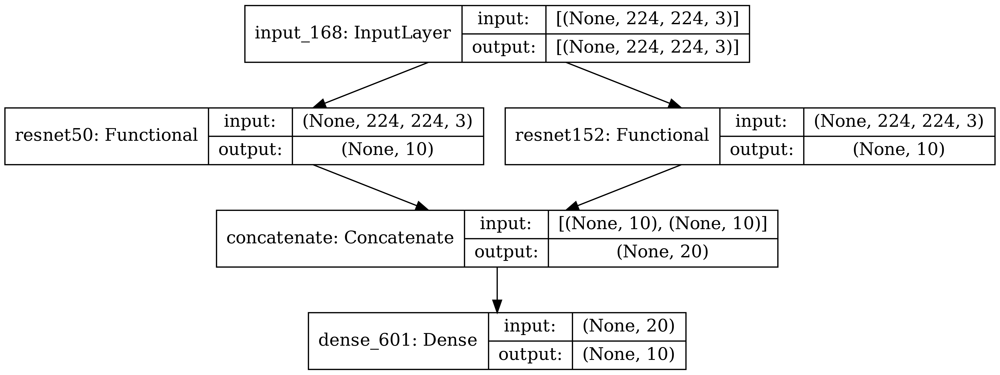

In [ ]:
from tensorflow.keras.applications import ResNet50, ResNet152
inp = L.Input((a, b, 3))
resnet50 = ResNet50(input_shape = (a, b, 3),
                    classes = c,
                    weights = None)
resnet50out = resnet50(inp)
resnet121 = ResNet152(input_shape = (a, b, 3),
                      classes = c,
                      weights = None)
resnet121out = resnet121(inp)
concat = L.Concatenate()([resnet50out, resnet121out])
out = L.Dense(c, activation='softmax')(concat)
model = keras.models.Model(inputs = inp,
                           outputs = out)

keras.utils.plot_model(model, show_shapes=True, dpi=400)

---

## Multi-Modal Models

In [1]:
class MultiModalData(tf.keras.utils.Sequence):
 
    def __init__(self, 
                 imageCol, targetCol,
                 tabularFeatures, oneHotFeatures,
                 imageDir, csvDir,
                 batchSize = 8, train_size = 0.8,
                 targetScale = 1000):
        
        self.batchSize = batchSize
        self.imageDir = imageDir
        
        df = pd.read_csv(csvDir)
        self.imagePaths = df[imageCol]
        self.targetCol = df[targetCol] / targetScale
        self.tabular = df.drop([imageCol, targetCol],
                               axis = 1)[tabularFeatures]
        for feature in oneHotFeatures:
            self.tabular = self.tabular.join(pd.get_dummies(self.tabular[feature]))
            self.tabular.drop(feature, axis=1, inplace=True)
        
        self.dataSize = len(df)
        self.trainSize = round(self.dataSize * train_size)
        
        dataIndices = np.array(df.index)
        self.trainInd = np.random.choice(dataIndices,
                                         size = self.trainSize)
        self.validInd = np.array([i for i in dataIndices if i not in self.trainInd])
        
    def __len__(self):
        return self.trainSize // self.batchSize
    
    def __getitem__(self, index):
        images, tabulars, y = [], [], []
        for i in range(self.batchSize):
            currIndex = index * self.batchSize + i
            imagePath = f'{self.imageDir}/{self.imagePaths[currIndex]}.jpg'
            image = cv2.resize(cv2.imread(imagePath), (400, 400))
            tabular = np.array(self.tabular.loc[currIndex])
            target = self.targetCol[currIndex]
            images.append(image)
            tabulars.append(tabular)
            y.append(target)
        return [np.stack(images), np.stack(tabulars)], np.stack(y)

NameError: ignored

In [ ]:
data = MultiModalData(imageCol = 'image_id',
                      targetCol = 'price',
                      tabularFeatures = ['n_citi', 'bed', 'bath', 'sqft'],
                      oneHotFeatures = ['n_citi'],
                      imageDir = '../input/house-prices-and-images-socal/socal2/socal_pics',
                      csvDir = '../input/house-prices-and-images-socal/socal2.csv',)

In [ ]:
x, y = data.__getitem__(0)
print(x[0].shape)
print(x[1].shape)
print(y.shape)

In [ ]:
imgInput = L.Input((400, 400, 3))
x = L.Conv2D(8, (3, 3), activation='relu', padding='valid')(imgInput)
for filters in [8, 8, 16, 16, 32, 32]:
    x1 = L.Conv2D(filters, (1, 1), activation='relu', padding='same')(x)
    x2 = L.Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
    x3a = L.Conv2D(filters, (5, 5), activation='relu', padding='same')(x)
    x3b = L.Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
    add = L.Add()([x1, x2, x3b])
    x = L.MaxPooling2D((2, 2))(add)
flatten = L.Flatten()(x)
imgDense1 = L.Dense(64, activation='relu')(flatten)
imgDense2 = L.Dense(32, activation='relu')(imgDense1)
imgOut = L.Dense(16, activation='relu')(imgDense2)

tabularInput = L.Input((418,))
tabDense1 = L.Dense(16, activation='relu')(tabularInput)
tabDense2 = L.Dense(16, activation='relu')(tabDense1)
tabOut = L.Dense(16, activation='relu')(tabDense2)

concat = L.Concatenate()([imgOut, tabOut])
dense1 = L.Dense(16, activation='relu')(concat)
dense2 = L.Dense(16, activation='relu')(dense1)
out = L.Dense(1, activation='relu')(dense2)

model = keras.models.Model(inputs = [imgInput, tabularInput],
                           outputs = out)

In [ ]:
model.compile(optimizer='adam',
              loss='mse',
              metrics=['mae'])

history = model.fit(data, epochs = 100)

plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['loss'], color='red', label='Train')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

Improved dataset implementation:

In [ ]:
class MultiModalData(tf.keras.utils.Sequence):
 
    def __init__(self, 
                 imageCol, targetCol,
                 tabularFeatures, embeddingFeature,
                 imageDir, csvDir,
                 batchSize = 8, train_size = 0.8,
                 targetScale = 1000):
        
        self.batchSize = batchSize
        self.imageDir = imageDir
        
        df = pd.read_csv(csvDir)
        self.imagePaths = df[imageCol]
        self.targetCol = df[targetCol] / targetScale
        self.tabular = df.drop([imageCol, targetCol],
                               axis = 1)[tabularFeatures]
        self.onehotData = self.tabular[embeddingFeature]
        self.tabular.drop(embeddingFeature, axis=1, inplace=True)
        
        self.dataSize = len(df)
        self.trainSize = round(self.dataSize * train_size)
        
        dataIndices = np.array(df.index)
        self.trainInd = np.random.choice(dataIndices,
                                         size = self.trainSize)
        self.validInd = np.array([i for i in dataIndices if i not in self.trainInd])
        
    def __len__(self):
        return self.trainSize // self.batchSize
    
    def __getitem__(self, index):
        images, embeddingInps, tabulars, y = [], [], [], []
        for i in range(self.batchSize):
            currIndex = index * self.batchSize + i
            imagePath = f'{self.imageDir}/{self.imagePaths[currIndex]}.jpg'
            image = cv2.resize(cv2.imread(imagePath), (400, 400))
            embeddingInp = np.array(self.onehotData.loc[currIndex])
            tabular = np.array(self.tabular.loc[currIndex])
            target = self.targetCol[currIndex]
            images.append(image)
            embeddingInps.append(embeddingInp)
            tabulars.append(tabular)
            y.append(target)
        return [np.stack(images), np.stack(embeddingInps), np.stack(tabulars)], np.stack(y)

In [ ]:
data = MultiModalData(imageCol = 'image_id',
                      targetCol = 'price',
                      tabularFeatures = ['n_citi', 'bed', 'bath', 'sqft'],
                      embeddingFeature = 'n_citi',
                      imageDir = '../input/house-prices-and-images-socal/socal2/socal_pics',
                      csvDir = '../input/house-prices-and-images-socal/socal2.csv',)

In [ ]:
x, y = data.__getitem__(0)
print(x[0].shape)
print(x[1].shape)
print(x[2].shape)
print(y.shape)

In [ ]:
from tensorflow.keras.applications import EfficientNetB1
 
imgInput = L.Input((400, 400, 3))
effnet = EfficientNetB1(input_shape = (400, 400, 3),
                        weights = None,
                        classes = 16)(imgInput)
imgOut = L.Dense(16, activation='relu')(effnet)
 
embeddingInput = L.Input((1,))
embedding = L.Embedding(415, 8)(embeddingInput)
reshape = L.Reshape((8,))(embedding)
 
tabularInput = L.Input((3,))
tabDense1 = L.Dense(4, activation='relu')(tabularInput)
tabDense2 = L.Dense(4, activation='relu')(tabDense1)
tabOut = L.Dense(4, activation='relu')(tabDense2)
 
concat = L.Concatenate()([imgOut, tabOut, reshape])
dense1 = L.Dense(16, activation='relu')(concat)
dense2 = L.Dense(16, activation='relu')(dense1)
out = L.Dense(1, activation='relu')(dense2)
 
model = keras.models.Model(inputs = [imgInput, embeddingInput, tabularInput],
                           outputs = out)

In [ ]:
model.compile(optimizer='adam',
              loss='mse',
              metrics=['mae'])

# history = model.fit(data, epochs = 100)

# plt.figure(figsize=(10, 5), dpi=400)
# plt.plot(history.history['loss'], color='red', label='Train')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.grid()
# plt.show()

---

## 1-D Convolutions

In [ ]:
numElements = 400
numTriSamples = 2000

x, y = [], []
baseRange = np.linspace(-5, 5, numElements)

for i in tqdm(range(numTriSamples)):
    
    # get random linear sample
    slope = np.random.uniform(-3, 3)
    intercept = np.random.uniform(-10, 10)
    x.append(baseRange * slope + intercept)
    y.append(0)
    
    # get random quadratic sample
    a = np.random.choice([np.random.uniform(0.2, 1),
                          np.random.uniform(-0.2, -1)])
    b = np.random.uniform(-1, 1)
    c = np.random.uniform(-1, 1)
    x.append(a * baseRange**2 + b * baseRange + c)
    y.append(1)
    
    # get random sinusoidal sample
    a = np.random.uniform(1, 10)
    b = np.random.uniform(1, 3)
    c = np.random.uniform(-np.pi, np.pi)
    d = np.random.uniform(-20, 20)
    x.append(a * np.sin(b * baseRange - c) + d)
    y.append(2)
    
x = np.array(x)
x += np.random.normal(loc = 0, scale = 1,
                      size = x.shape)
y = np.array(y)

  0%|          | 0/2000 [00:00<?, ?it/s]

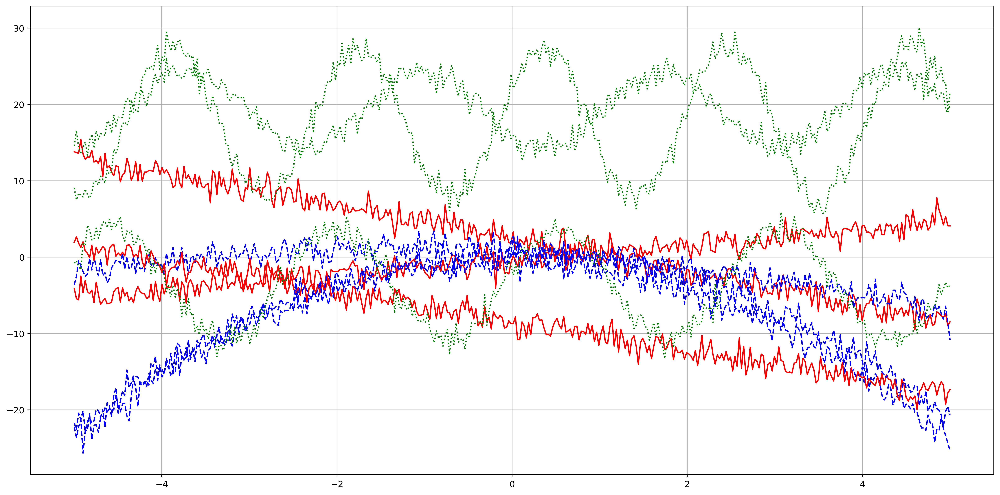

In [ ]:
plt.figure(figsize=(20, 10), dpi=400)
colors = ['red', 'blue', 'green']
styles = ['-', '--', ':']
for i in range(9):
    plt.plot(baseRange, x[i], 
             color=colors[y[i]],
             linestyle=styles[y[i]])
plt.grid()
plt.show()

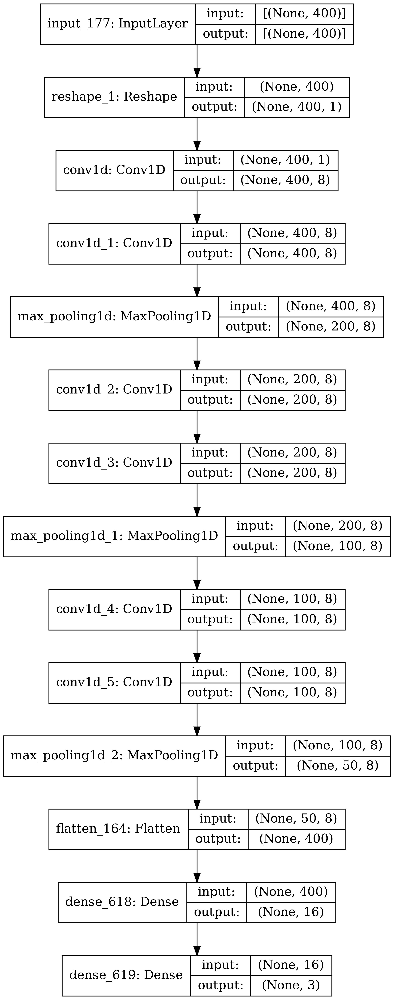

In [ ]:
model = Sequential()
model.add(L.Input(numElements))
model.add(L.Reshape((numElements, 1)))
for i in range(3):
    model.add(L.Conv1D(8, 3, padding='same', activation='relu'))
    model.add(L.Conv1D(8, 3, padding='same', activation='relu'))
    model.add(L.MaxPooling1D(2))
model.add(L.Flatten())
model.add(L.Dense(16, activation='relu'))
model.add(L.Dense(3, activation='softmax'))

keras.utils.plot_model(model, show_shapes = True, dpi=400)

In [ ]:
from sklearn.model_selection import train_test_split as tts
X_train, X_val, y_train, y_val = tts(x, y, train_size = 0.8)

In [ ]:
model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
history = model.fit(X_train, y_train,
                    epochs = 0,
                    validation_data = (X_val, y_val))

In [ ]:
plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['loss'], color='red', label='Train')
plt.plot(history.history['val_loss'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['accuracy'], color='red', label='Train')
plt.plot(history.history['val_accuracy'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

Applying 1D soft ordering CNNs to the Forest Cover Type dataset.

In [ ]:
data = pd.read_csv('../input/forest-cover-type-dataset/covtype.csv')

In [ ]:
from sklearn.model_selection import train_test_split as tts
X_train, X_val, y_train, y_val = tts(data.drop('Cover_Type', axis=1),
                                     data['Cover_Type'] - 1,
                                     train_size = 0.8,
                                     random_state = 101)

In [ ]:
numElements = len(data.columns) - 1

inp = L.Input(numElements)
d1 = L.Dense(numElements*4, activation='relu')(inp)
d2 = L.Dense(numElements*8, activation='relu')(d1)
x = L.Reshape((numElements, 8))(d2)
for i in range(3):
    x1a = L.Conv1D(8, 3, padding='same', activation='relu')(x)
    x1b = L.Conv1D(8, 3, padding='same', activation='relu')(x1a)
    x2a = L.Conv1D(8, 5, padding='same', activation='relu')(x)
    x2b = L.Conv1D(8, 3, padding='same', activation='relu')(x2a)
    x3 = L.Conv1D(8, 2, padding='same', activation='relu')(x)
    add = L.Add()([x1b, x2b, x3])
    x = L.AveragePooling1D(2)(add)
flatten = L.Flatten()(x)
d3 = L.Dense(16, activation='relu')(flatten)
d4 = L.Dense(16, activation='relu')(d3)

dAlt1 = L.Dense(numElements*4, activation='relu')(d1)
dAlt2 = L.Dense(numElements*4, activation='relu')(dAlt1)
dAlt3 = L.Dense(numElements*4, activation='relu')(dAlt2)
dAlt4 = L.Dense(16, activation='relu')(dAlt3)

combine = L.Concatenate()([d4, dAlt3])
dOut1 = L.Dense(16, activation='relu')(combine)
dOut2 = L.Dense(8, activation='relu')(dOut1)

out = L.Dense(7, activation='softmax')(dOut2)

model = keras.models.Model(inputs = inp, outputs = out)

keras.utils.plot_model(model, show_shapes=True, dpi=400)

In [ ]:
model.summary()

Model: "model_96"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_178 (InputLayer)          [(None, 54)]         0                                            
__________________________________________________________________________________________________
dense_620 (Dense)               (None, 216)          11880       input_178[0][0]                  
__________________________________________________________________________________________________
dense_621 (Dense)               (None, 432)          93744       dense_620[0][0]                  
__________________________________________________________________________________________________
reshape_2 (Reshape)             (None, 54, 8)        0           dense_621[0][0]                  
___________________________________________________________________________________________

In [ ]:
model.compile(optimizer=keras.optimizers.Adam(learning_rate=1e-3),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

callbacks = keras.callbacks.ReduceLROnPlateau(patience = 10,
                                              factor = 1/5,
                                              min_lr = 1e-5)

history = model.fit(X_train, y_train, epochs=0,
                    validation_data = (X_val, y_val),
                    batch_size = 256)

In [ ]:
plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['loss'], color='red', label='Train')
plt.plot(history.history['val_loss'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['accuracy'], color='red', label='Train')
plt.plot(history.history['val_accuracy'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

---

## 2-D Convolutions

### DeepInsight

In [ ]:
!python3 -m pip -q install git+https://github.com/alok-ai-lab/pyDeepInsight.git#egg=pyDeepInsight

In [ ]:
import pyDeepInsight

In [ ]:
data = pd.read_csv('../input/mpempe/mouse-protein-expression.csv')

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(data.drop('class',axis=1),
                                                    data['class'],
                                                    train_size=0.8)
y_train = keras.utils.to_categorical(y_train)
y_test = keras.utils.to_categorical(y_test)

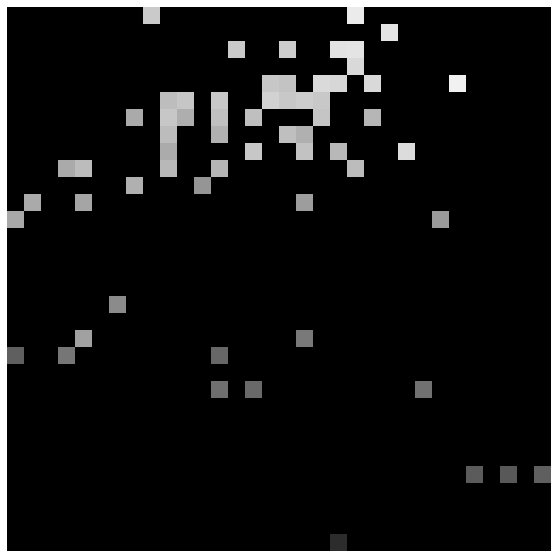

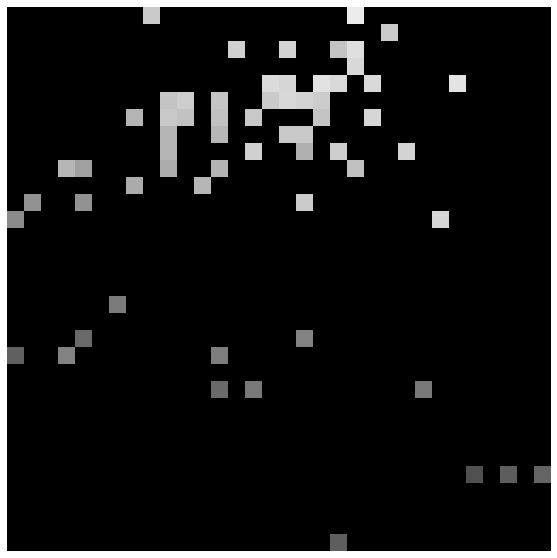

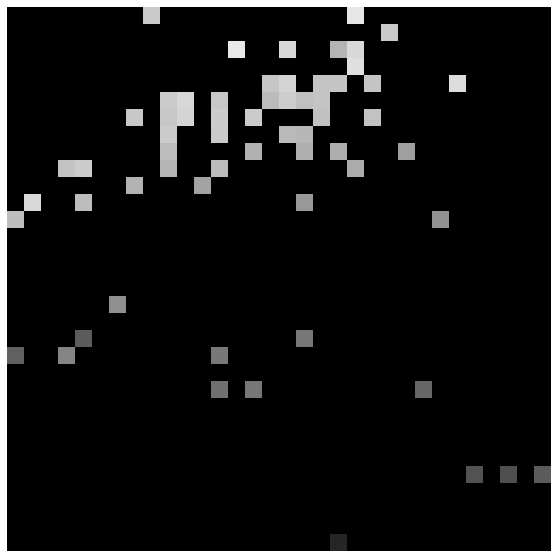

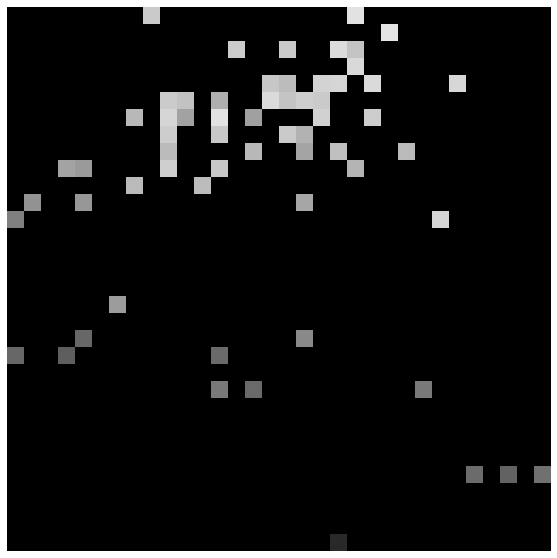

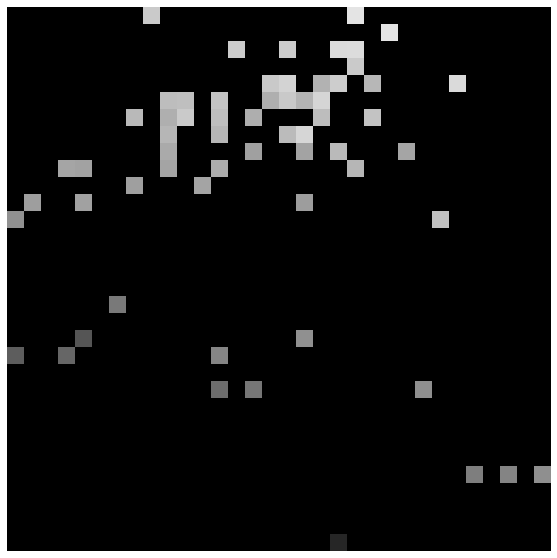

In [ ]:
from pyDeepInsight import ImageTransformer, LogScaler
ln = LogScaler()
X_train_norm = ln.fit_transform(X_train)
X_test_norm = ln.transform(X_test)
it = ImageTransformer(feature_extractor='kpca', 
                      pixels=32)
tf_train_x = it.fit_transform(X_train_norm)
tf_test_x = it.transform(X_test_norm)

for i in range(5):
    plt.figure(figsize=(10,10))
    plt.imshow(tf_train_x[i])
    plt.axis('off')
    plt.savefig(f'{i}.png', dpi=400)
    plt.show()

In [ ]:
# input
inp = L.Input((32,32,3))

# branch 1
x = inp
for i in range(3):
    x = L.Conv2D(2**(i+3), (2,1), padding='same')(x)
    x = L.Conv2D(2**(i+3), (1,2), padding='same')(x)
    x = L.Conv2D(2**(i+3), (2,2), padding='same')(x)
    x = L.BatchNormalization()(x)
    x = L.Activation('relu')(x)
    x = L.MaxPooling2D((2,2))(x)
    x = L.Dropout(0.3)(x)
x = L.Conv2D(64, (2,2), padding='same')(x)
x = L.BatchNormalization()(x)
branch_1 = L.Activation('relu')(x)

# branch 2
x = inp
for i in range(3):
    x = L.Conv2D(2**(i+3), (5,1), padding='same')(x)
    x = L.Conv2D(2**(i+3), (1,5), padding='same')(x)
    x = L.Conv2D(2**(i+3), (5,5), padding='same')(x)
    x = L.BatchNormalization()(x)
    x = L.Activation('relu')(x)
    x = L.MaxPooling2D((2,2))(x)
    x = L.Dropout(0.3)(x)
x = L.Conv2D(64, (5,5), padding='same')(x)
x = L.BatchNormalization()(x)
branch_2 = L.Activation('relu')(x)

# concatenate + output
concat = L.Concatenate()([branch_1, branch_2])
global_pool = L.GlobalAveragePooling2D()(concat)
fc1 = L.Dense(32, activation='relu')(global_pool)
fc2 = L.Dense(32, activation='relu')(fc1)
fc3 = L.Dense(32, activation='relu')(fc2)
out = L.Dense(9, activation='softmax')(fc3)

# aggregate into model
model = keras.models.Model(inputs=inp, outputs=out)

In [ ]:
keras.utils.plot_model(model, show_shapes=True, dpi=400)

In [ ]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
history = model.fit(tf_train_x, y_train, epochs=0, validation_data=(tf_test_x, y_test)) # train for more epochs for better results

In [ ]:
plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['loss'], color='red', label='Train')
plt.plot(history.history['val_loss'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

In [ ]:
plt.figure(figsize=(10, 5), dpi=400)
plt.plot(history.history['accuracy'], color='red', label='Train')
plt.plot(history.history['val_accuracy'], color='blue', label='Validation')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

### IGTD

In [ ]:
!wget -O IGTD_Functions.py https://raw.githubusercontent.com/zhuyitan/IGTD/With_CNN_Prediction/Scripts/IGTD_Functions.py
import IGTD_Functions
import importlib
importlib.reload(IGTD_Functions)

In [ ]:
from IGTD_Functions import table_to_image

In [ ]:
num_row = 8
num_col = 10
num = num_row * num_col
save_image_size = 10 
max_step = 10000
val_step = 300

fea_dist_method = 'Pearson'
image_dist_method = 'Euclidean'
error = 'squared'
result_dir = 'images'
os.makedirs(name=result_dir, exist_ok=True)
table_to_image(norm_data, [num_row, num_col],
               fea_dist_method,
               image_dist_method,
               save_image_size,
               max_step,
               val_step,
               result_dir,
               error)

In [ ]:
with open('images/data/_136_data.txt', 'r') as f:
    a = f.read()
plt.figure(figsize=(10, 10), dpi=400)
arr = plt.imread('images/data/_506_image.png')
plt.imshow(arr)
plt.axis('off')
plt.show()

In [ ]:
plt.figure(figsize=(10, 10), dpi=400)
arr = plt.imread('images/data/_827_image.png')
plt.imshow(arr)
plt.axis('off')
plt.show()

In [ ]:
plt.figure(figsize=(10, 10), dpi=400)
arr = plt.imread('images/optimized_feature_ranking.png')
plt.imshow(arr)
plt.axis('off')
plt.show()

In [ ]:
plt.figure(figsize=(10, 10), dpi=400)
arr = plt.imread('images/original_feature_ranking.png')
plt.imshow(arr)
plt.axis('off')
plt.show()

---